# Продолжение кода по композитным материалам

In [1]:
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import plotly.express as px
import tensorflow as tf
import sklearn

from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import Normalizer, LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor

from tensorflow import keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Activation
from pandas import read_excel, DataFrame, Series
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from tensorflow.keras.models import Sequential
from numpy.random import seed
from scipy import stats
import warnings
warnings.filterwarnings("ignore")

In [2]:
current_dir = os.path.abspath(os.getcwd())

In [3]:
df = pd.read_excel(current_dir + r"\Itog\itog.xlsx")
# сразу удаляем неинформативный столбец
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [4]:
#Создадим переменную для названия всех столбцов. Это нам пригодится при построении моделей. И перейдем к визуализации данных
df.columns
#column_names = ["Соотношение матрица-наполнитель","Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%",
#         "Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2",
#         "Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",
#        "Угол нашивки, град","Шаг нашивки","Плотность нашивки"]
column_names = df.columns

# Проведем предобработку данных

In [5]:
#Вспомним, что пропуски в данных отсутствуют. Значит, сразу приступаем к работе с выбросами
# Шаг 1 Удаление выбросов. Посчитаем, сколько значений у нас в каждом столбце выбивающихся из распределения.
df.isna().sum()
#Т.к.значений не очень много, их вполне можно исключить.

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [6]:
#Для удаления выбросов существует 2 основных метода - метод 3-х сигм и межквартильных расстояний. Сравним эти 2 метода.
metod_3s = 0
metod_iq = 0
count_iq = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма методом.
count_3s = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма.
for column in df:
    d = df.loc[:, [column]]
    # методом 3-х сигм
    zscore = (df[column] - df[column].mean()) / df[column].std()
    d['3s'] = zscore.abs() > 3
    metod_3s += d['3s'].sum()
    count_3s.append(d['3s'].sum())
    print(column,'3s', ': ', d['3s'].sum())

    # методом межквартильных расстояний
    q1 = np.quantile(df[column], 0.25)
    q3 = np.quantile(df[column], 0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    d['iq'] = (df[column] <= lower) | (df[column] >= upper)
    metod_iq += d['iq'].sum()
    count_iq.append(d['iq'].sum())
    print(column, ': ', d['iq'].sum())
print('Метод 3-х сигм, выбросов:', metod_3s)
print('Метод межквартильных расстояний, выбросов:', metod_iq)

Соотношение матрица-наполнитель 3s :  0
Соотношение матрица-наполнитель :  6
Плотность, кг/м3 3s :  3
Плотность, кг/м3 :  9
модуль упругости, ГПа 3s :  2
модуль упругости, ГПа :  2
Количество отвердителя, м.% 3s :  2
Количество отвердителя, м.% :  14
Содержание эпоксидных групп,%_2 3s :  2
Содержание эпоксидных групп,%_2 :  2
Температура вспышки, С_2 3s :  3
Температура вспышки, С_2 :  8
Поверхностная плотность, г/м2 3s :  2
Поверхностная плотность, г/м2 :  2
Модуль упругости при растяжении, ГПа 3s :  0
Модуль упругости при растяжении, ГПа :  6
Прочность при растяжении, МПа 3s :  0
Прочность при растяжении, МПа :  11
Потребление смолы, г/м2 3s :  3
Потребление смолы, г/м2 :  8
Угол нашивки 3s :  0
Угол нашивки :  0
Шаг нашивки 3s :  0
Шаг нашивки :  4
Плотность нашивки 3s :  7
Плотность нашивки :  21
Метод 3-х сигм, выбросов: 24
Метод межквартильных расстояний, выбросов: 93


In [7]:
# С целью предотвращения удаления особенностей признака или допущения ошибки, посчитаем распределение выбросов по каждому столбцу.

In [8]:
m = df.copy()
for i in df.columns:
    m[i] = abs((df[i] - df[i].mean()) / df[i].std())
    print(f"{sum(m[i] > 3)} выбросов в признаке {i}")
print(f' Всего {sum(sum(m.values > 3))} выброса')

0 выбросов в признаке Соотношение матрица-наполнитель
3 выбросов в признаке Плотность, кг/м3
2 выбросов в признаке модуль упругости, ГПа
2 выбросов в признаке Количество отвердителя, м.%
2 выбросов в признаке Содержание эпоксидных групп,%_2
3 выбросов в признаке Температура вспышки, С_2
2 выбросов в признаке Поверхностная плотность, г/м2
0 выбросов в признаке Модуль упругости при растяжении, ГПа
0 выбросов в признаке Прочность при растяжении, МПа
3 выбросов в признаке Потребление смолы, г/м2
0 выбросов в признаке Угол нашивки
0 выбросов в признаке Шаг нашивки
7 выбросов в признаке Плотность нашивки
 Всего 24 выброса


In [9]:
# Результаты показывают, что выбросы распределены по разным признакам. Какого-то скопления выбросов в одном из признаков не обнаружено. Поэтому можно удалять выбросы, потому что глобальных изменений в зависимостях они не дадут.

In [10]:
#Создадим переменную со списком всех параметров, в которых есть выбросы
df.columns
column_list_drop = ["Соотношение матрица-наполнитель",
                 "Плотность, кг/м3",
                 "модуль упругости, ГПа",
                 "Количество отвердителя, м.%",
                 "Содержание эпоксидных групп,%_2",
                 "Температура вспышки, С_2",
                 "Поверхностная плотность, г/м2",
                 "Модуль упругости при растяжении, ГПа",
                 "Прочность при растяжении, МПа",
                 "Потребление смолы, г/м2",
                 "Шаг нашивки",
                 "Плотность нашивки"]

In [11]:
# Исключим выбросы, очистим данные от выбросов методом межквартильного расстояния (далее 1,5 межквартильных размахов)
# Выбор сделан в пользу этого метода, потому что хотим добиться в данной работе полностью избавления от выборов, и метод межквартильного расстояния позволяет удалить практически 10% датасета сразу
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i], [75,25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

In [12]:
# Так же для удаления выбросов можно использовать вот эту формулу, но мне привычней вариант выше:
#df = df[~((df<(min))|(df>(max))).any(axis=1)]
#df

In [13]:
# Можно так же удалить выборосы методом 3-х сигм, но мы не будем. Просто отсвим код здесь на будущее
m_3s = pd.DataFrame(index=df.index)
for column in df:
    zscore = (df[column] - df[column].mean()) / df[column].std()
    m_3s[column] = (zscore.abs() > 3)
df = df[m_3s.sum(axis=1)==0]
df.shape

(1023, 13)

In [14]:
#Посмотрим на сумму выбросов по каждому из столбцов
df.isnull().sum()
#Всего 64 выброса, можно их удалить.

Соотношение матрица-наполнитель          6
Плотность, кг/м3                         9
модуль упругости, ГПа                    2
Количество отвердителя, м.%             14
Содержание эпоксидных групп,%_2          2
Температура вспышки, С_2                 8
Поверхностная плотность, г/м2            2
Модуль упругости при растяжении, ГПа     6
Прочность при растяжении, МПа           11
Потребление смолы, г/м2                  8
Угол нашивки                             0
Шаг нашивки                              4
Плотность нашивки                       21
dtype: int64

In [15]:
#Удаляем строки c выбросами
df = df.dropna(axis=0)

In [16]:
#И еще раз посмотрим на сумму выбросов по каждому из столбцов, чтобы убедиться, что все работает
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [17]:
#Просмотрим информацию о "чистом" датасете после удаления пропусков. Видим, что строк стало меньше
df.info()
# После удаления выбросов в датасете осталось 936 строк и 13 колонок

<class 'pandas.core.frame.DataFrame'>
Int64Index: 936 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       936 non-null    float64
 1   Плотность, кг/м3                      936 non-null    float64
 2   модуль упругости, ГПа                 936 non-null    float64
 3   Количество отвердителя, м.%           936 non-null    float64
 4   Содержание эпоксидных групп,%_2       936 non-null    float64
 5   Температура вспышки, С_2              936 non-null    float64
 6   Поверхностная плотность, г/м2         936 non-null    float64
 7   Модуль упругости при растяжении, ГПа  936 non-null    float64
 8   Прочность при растяжении, МПа         936 non-null    float64
 9   Потребление смолы, г/м2               936 non-null    float64
 10  Угол нашивки                          936 non-null    int64  
 11  Шаг нашивки       

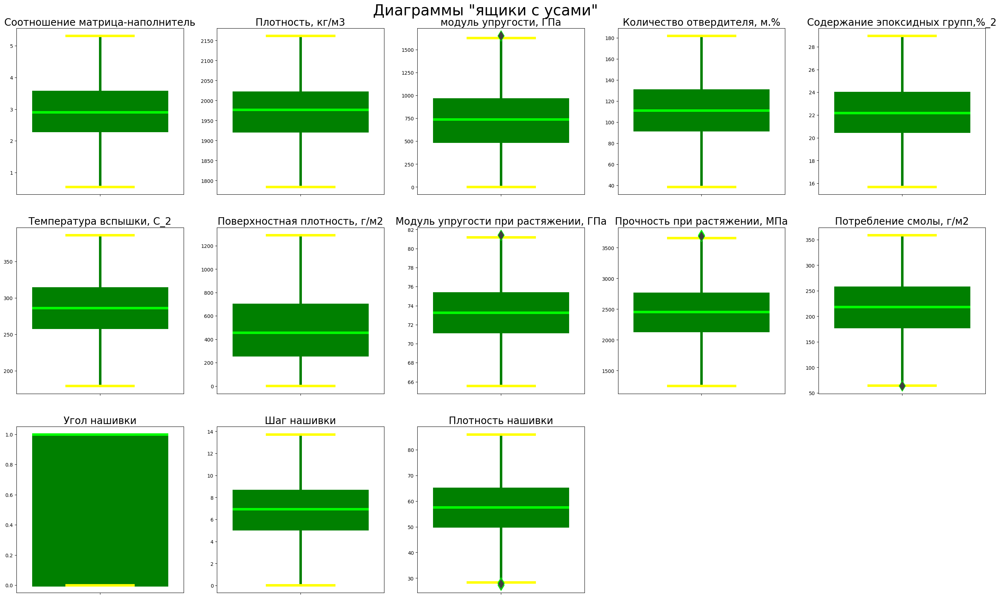

In [18]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

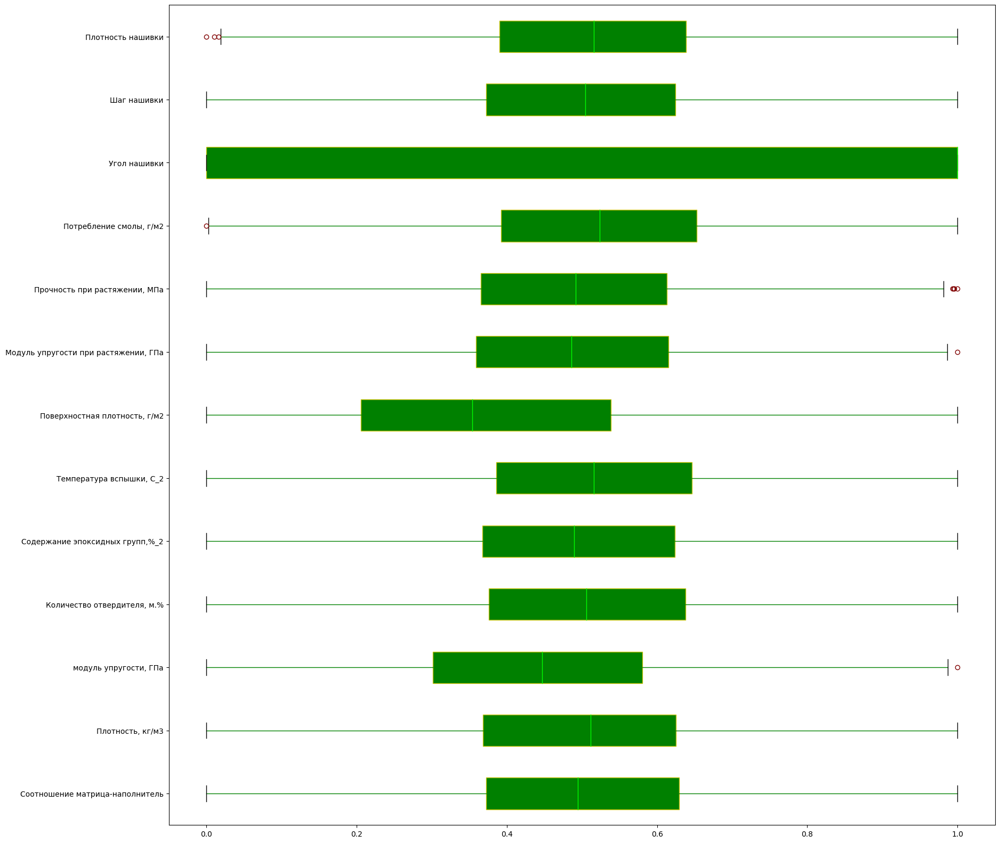

In [19]:
#Построим "ящики с усами" и наблюдаем все еще наличие выбросов
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
#Посмотрим на  "ящики с усами",чтобы наглядно увидеть, что выбросов нет, но они есть
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


In [20]:
# На графиках выше мы видим выбросы в некоторых столбцах. Они всё ещё есть, поэтому повторяем удаление выбросов

for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

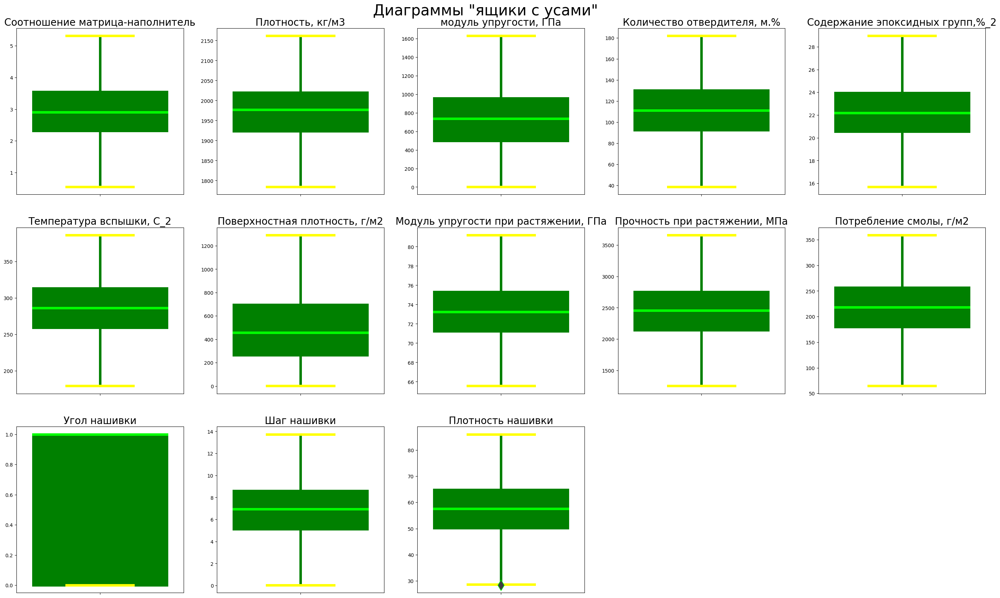

In [21]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize=(35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

In [22]:
df.skew()#ассиметрия по всем колонкам. Никак не использовал в дальнейшем.

Соотношение матрица-наполнитель         0.058917
Плотность, кг/м3                        0.002822
модуль упругости, ГПа                   0.070329
Количество отвердителя, м.%            -0.120959
Содержание эпоксидных групп,%_2         0.027075
Температура вспышки, С_2                0.007521
Поверхностная плотность, г/м2           0.357603
Модуль упругости при растяжении, ГПа    0.103130
Прочность при растяжении, МПа           0.063061
Потребление смолы, г/м2                -0.026155
Угол нашивки                           -0.047097
Шаг нашивки                             0.051818
Плотность нашивки                      -0.047335
dtype: float64

In [23]:
df.kurt()# эксцесс по всем колонкам. Никак не использовал в дальнейшем

Соотношение матрица-наполнитель        -0.308087
Плотность, кг/м3                       -0.215627
модуль упругости, ГПа                  -0.373035
Количество отвердителя, м.%            -0.249075
Содержание эпоксидных групп,%_2        -0.318102
Температура вспышки, С_2               -0.307474
Поверхностная плотность, г/м2          -0.548925
Модуль упругости при растяжении, ГПа   -0.308785
Прочность при растяжении, МПа          -0.217998
Потребление смолы, г/м2                -0.398795
Угол нашивки                           -2.002064
Шаг нашивки                            -0.114436
Плотность нашивки                      -0.193072
dtype: float64

In [24]:
#Проверим сумму выбросов по каждому из столбцов
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   1
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    1
Прочность при растяжении, МПа           4
Потребление смолы, г/м2                 1
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       3
dtype: int64

In [25]:
#И снова удаляем строки, которые содержат выбросы
df = df.dropna(axis=0)

In [26]:
#Третий раз проверим сумму выбросов по каждому столбцу
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [27]:
#Просмотрим информацию о нашем датасете после еще одного удаления пропусков. Видим, что строк стало еще меньше
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 926 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       926 non-null    float64
 1   Плотность, кг/м3                      926 non-null    float64
 2   модуль упругости, ГПа                 926 non-null    float64
 3   Количество отвердителя, м.%           926 non-null    float64
 4   Содержание эпоксидных групп,%_2       926 non-null    float64
 5   Температура вспышки, С_2              926 non-null    float64
 6   Поверхностная плотность, г/м2         926 non-null    float64
 7   Модуль упругости при растяжении, ГПа  926 non-null    float64
 8   Прочность при растяжении, МПа         926 non-null    float64
 9   Потребление смолы, г/м2               926 non-null    float64
 10  Угол нашивки                          926 non-null    int64  
 11  Шаг нашивки       

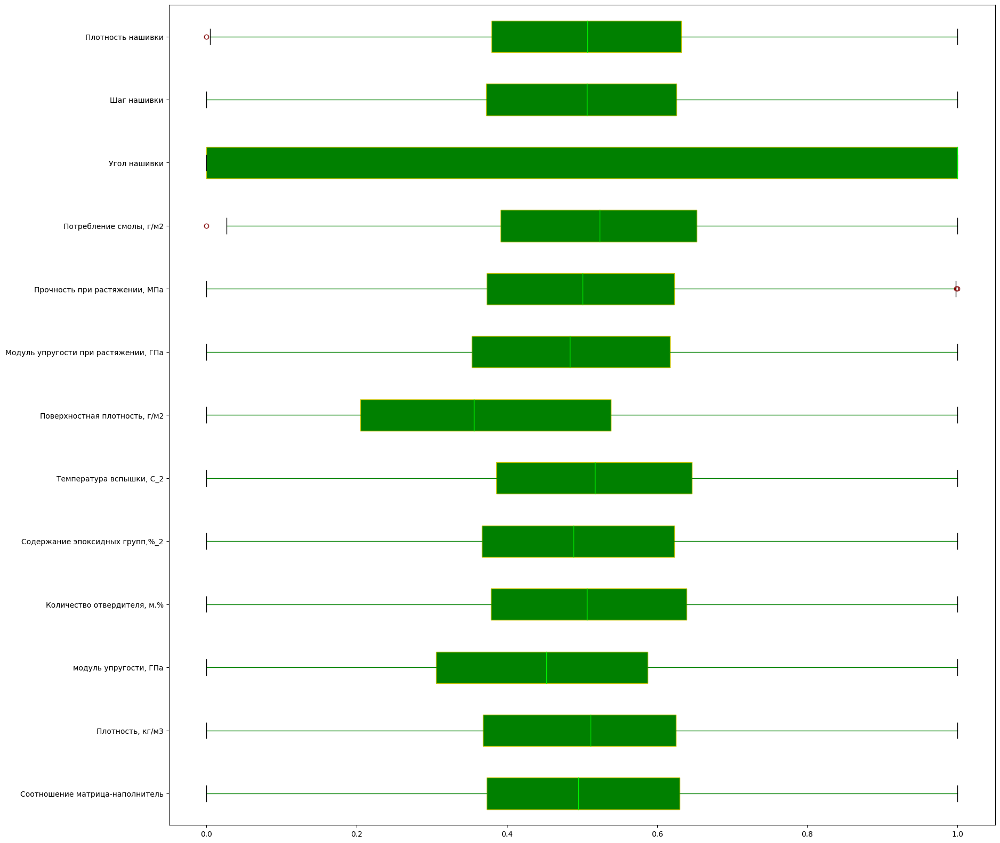

In [28]:
#В третий раз построим на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

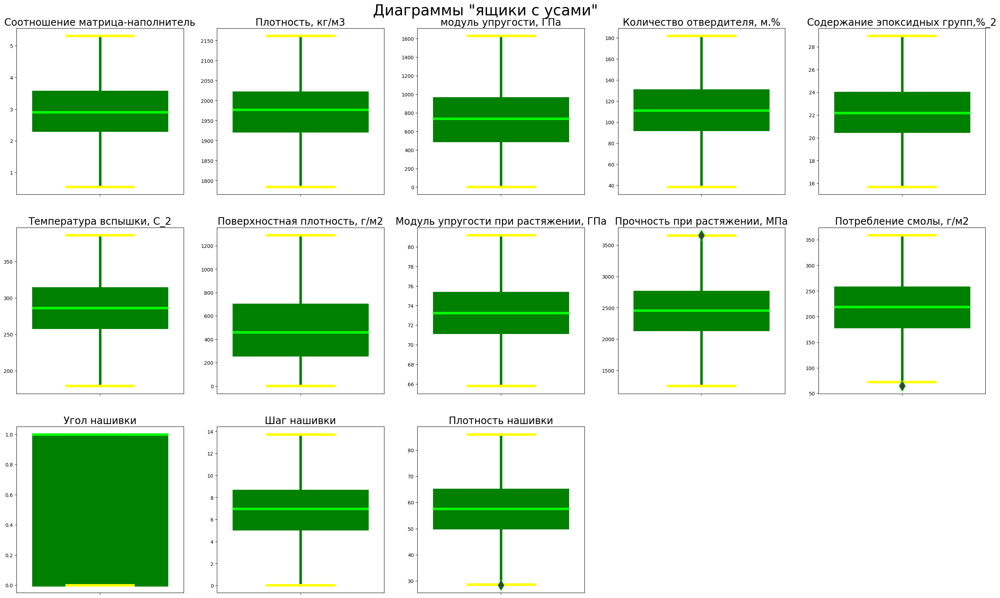

In [29]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

In [30]:
# И снова видим, что выбросы остались в некоторых исходных данных. Это вообще когда-нибудь закончится?о_О???

In [31]:
# Повторяем процедуру с выбросами еще раз. Надеюсь последний
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5*intr_qr)
    min = q25 - (1.5*intr_qr)
    df.loc[df[i] < min,i] = np.nan
    df.loc[df[i] > max,i] = np.nan

In [32]:
#Еще раз проверим сумму выбросов в каждом столбце
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           2
Потребление смолы, г/м2                 1
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       1
dtype: int64

In [33]:
#Еще раз удаляем строки с выбросами
df = df.dropna(axis=0)

In [34]:
#И проверочно посмотрим сумму выбросов
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [35]:
#Просмотрим на чистый датасет
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       922 non-null    float64
 1   Плотность, кг/м3                      922 non-null    float64
 2   модуль упругости, ГПа                 922 non-null    float64
 3   Количество отвердителя, м.%           922 non-null    float64
 4   Содержание эпоксидных групп,%_2       922 non-null    float64
 5   Температура вспышки, С_2              922 non-null    float64
 6   Поверхностная плотность, г/м2         922 non-null    float64
 7   Модуль упругости при растяжении, ГПа  922 non-null    float64
 8   Прочность при растяжении, МПа         922 non-null    float64
 9   Потребление смолы, г/м2               922 non-null    float64
 10  Угол нашивки                          922 non-null    int64  
 11  Шаг нашивки       

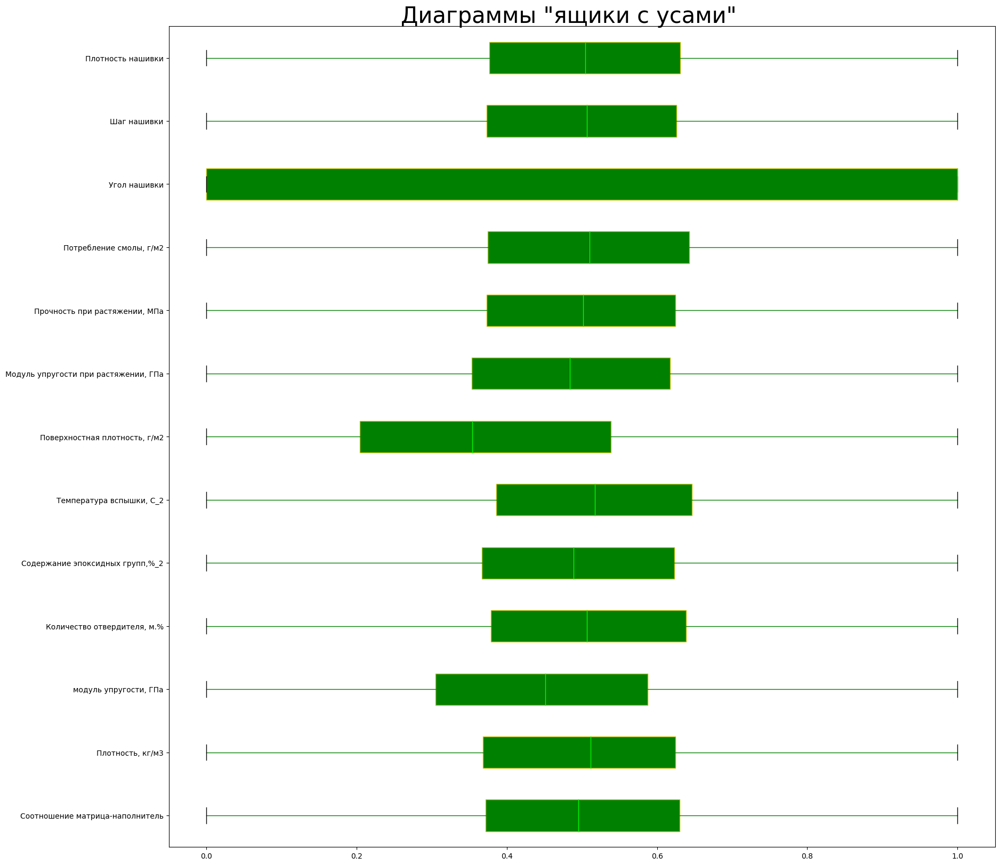

In [36]:
# "Ящики с усами"(боксплоты) (первый вариант)
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

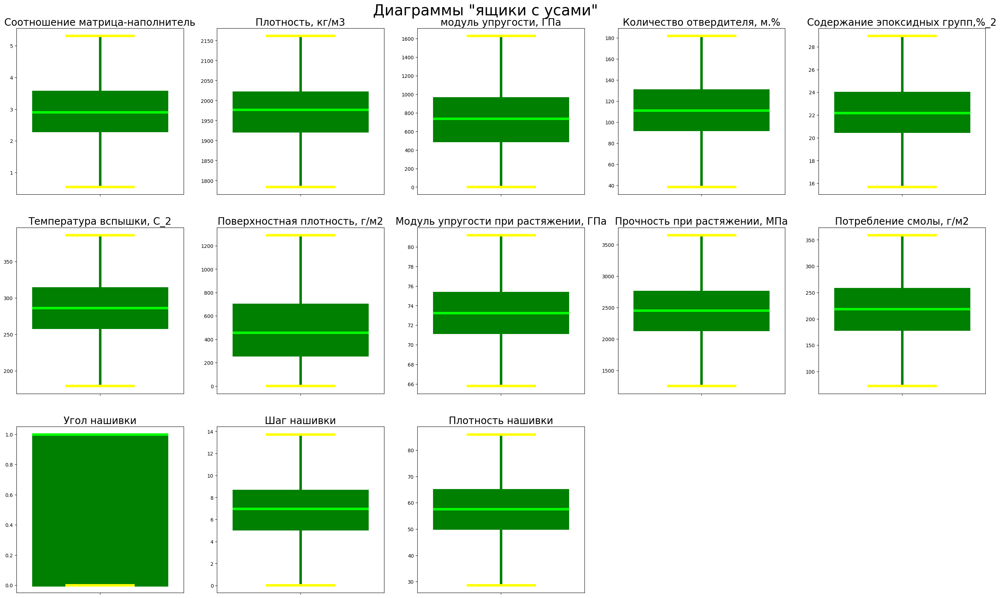

In [37]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

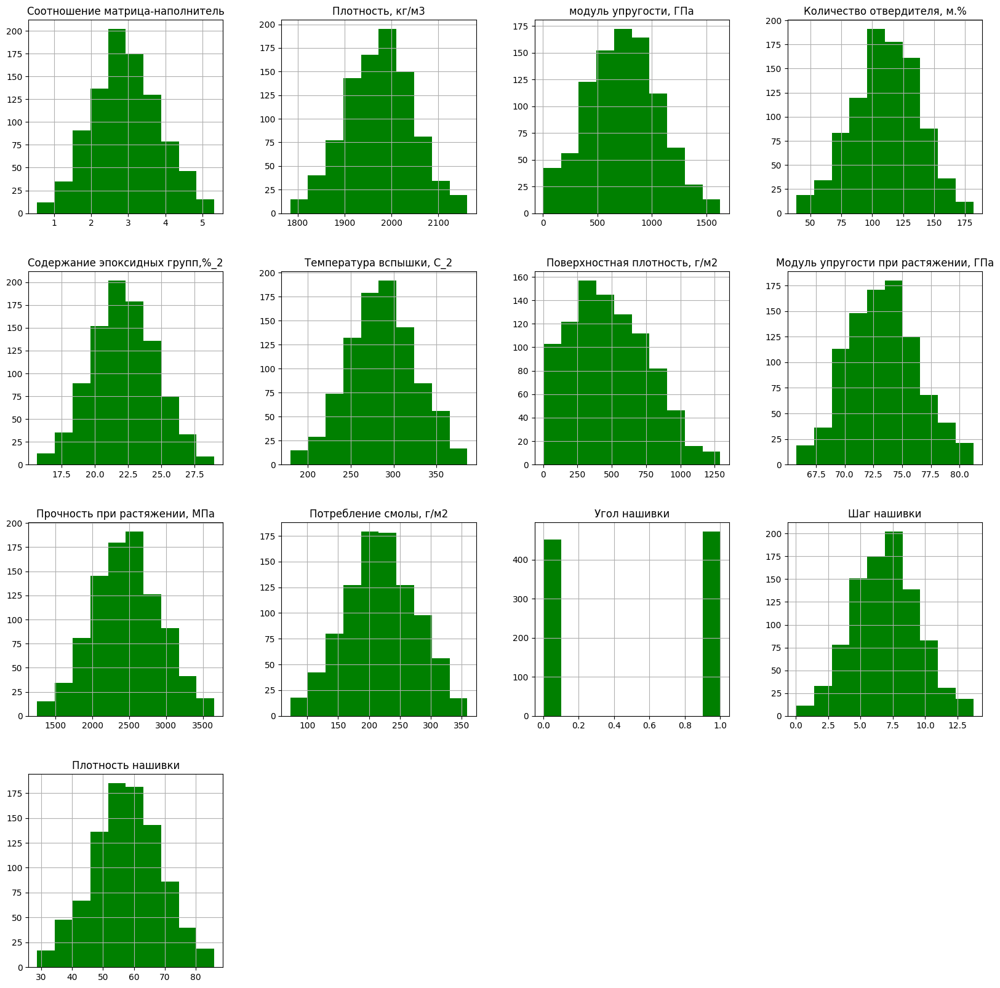

In [38]:
# Построим гистограммы распределения каждой из переменных без нормализации
df.hist(figsize = (20,20), color = "g")
plt.show()

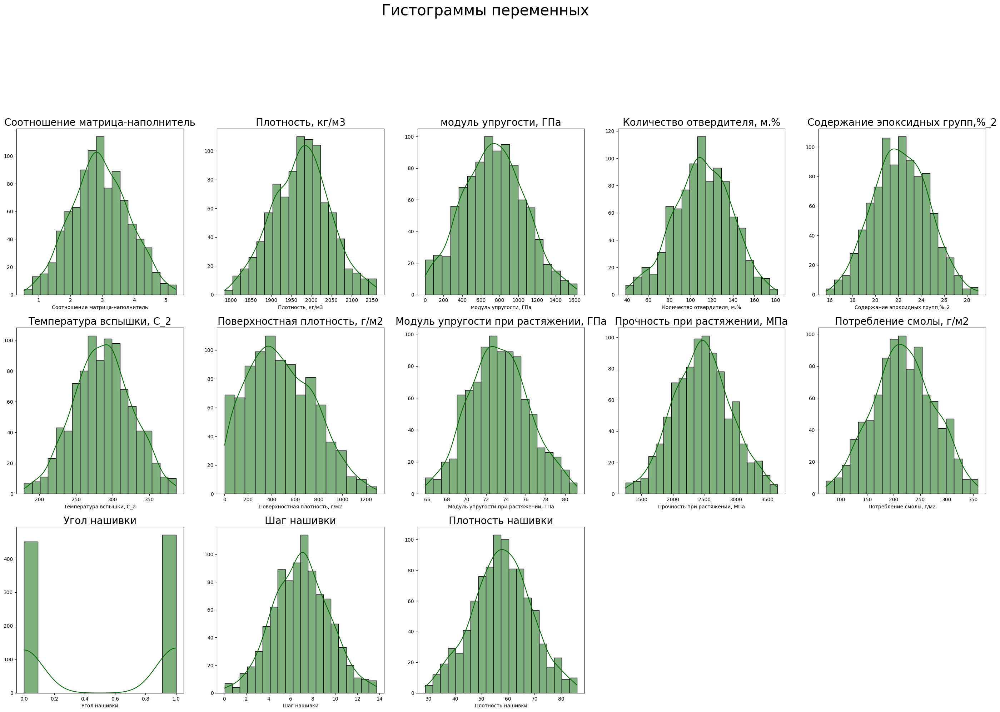

In [39]:
# Гистограмма распределения (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize=(35,35))
plt.suptitle('Гистограммы переменных', fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.histplot(data = df[col], kde = True, color = "darkgreen")
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1
#Данные стремятся к нормальному распределению практически везде, кроме угла нашивки, имеющим только 2 значения, с которым мы уже поработали ранее. 

In [40]:
# гистограмма распределения и боксплоты (третий вариант)

for column in df.columns:
    fig = px.histogram(df, x=column, color_discrete_sequence=['green'], nbins=100, marginal="box")
    fig.show()

In [41]:
for column in df.columns:
    fig = px.box(df, y=column)
    fig.show()

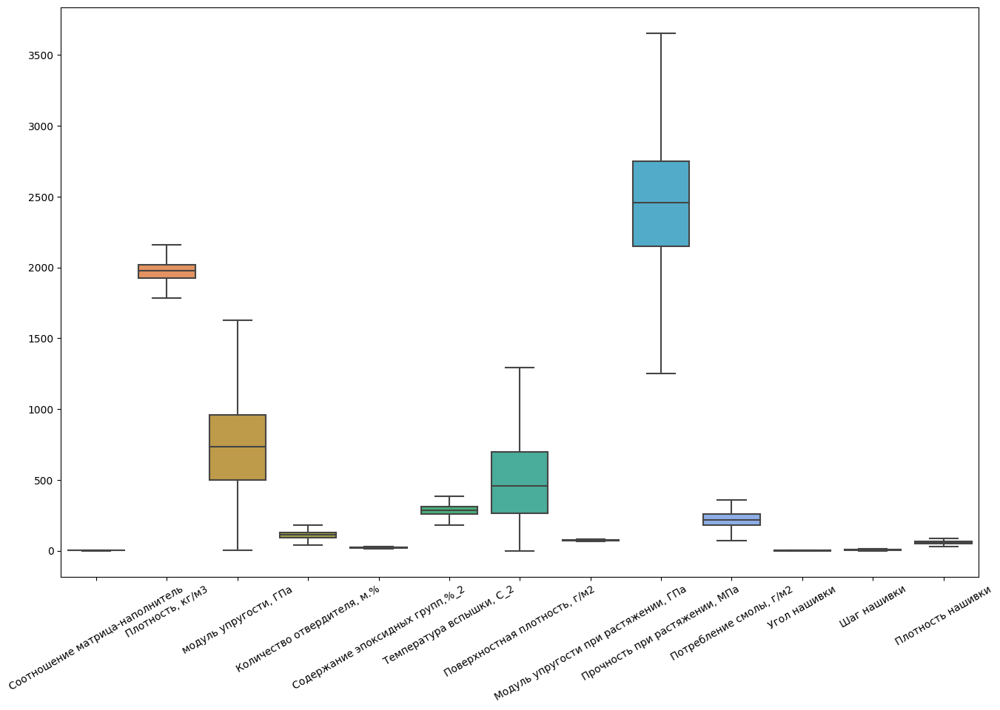

In [42]:
## Ящики с усами на одном рисунке
plt.figure(figsize=(16,10))
ax = sns.boxplot(data=df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

Соотношение матрица-наполнитель


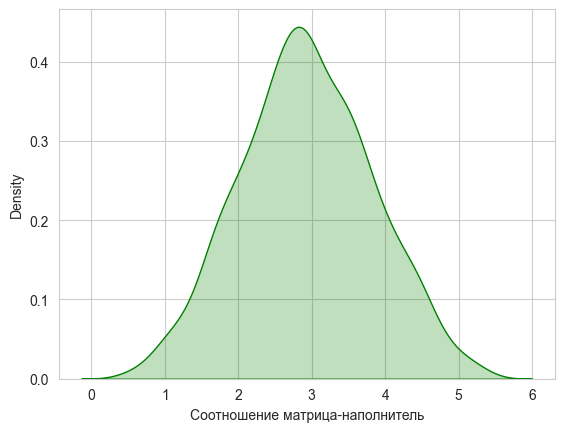

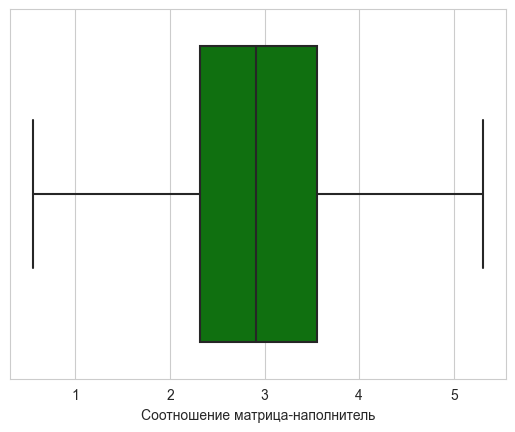

Минимальное значение:  0.547391007365624
Максимальное значение:  5.3141436851035
Среднее значение:  2.927963938445605
Медианное значение:  2.907832228399705



Плотность, кг/м3


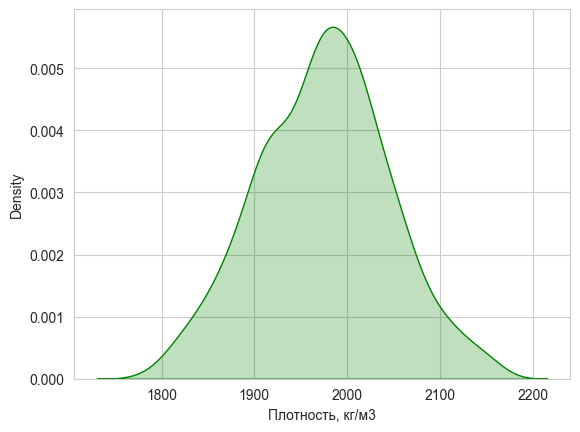

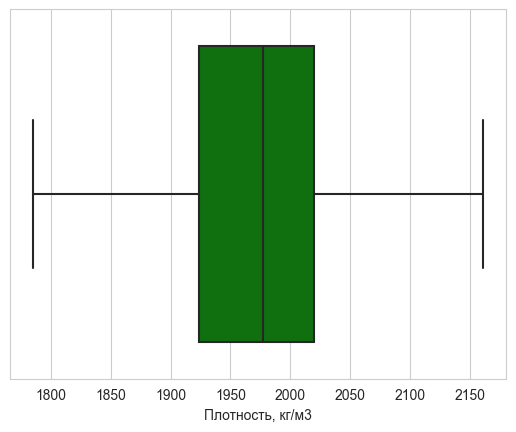

Минимальное значение:  1784.48224524858
Максимальное значение:  2161.56521646388
Среднее значение:  1974.1187441112245
Медианное значение:  1977.3210016945



модуль упругости, ГПа


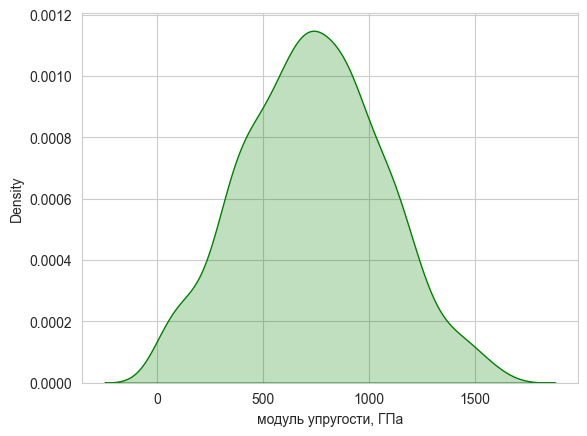

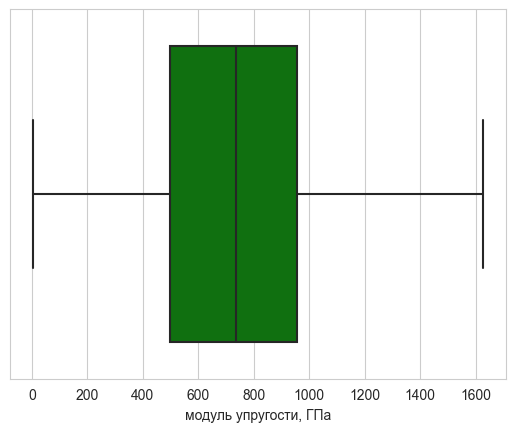

Минимальное значение:  2.4369087535075
Максимальное значение:  1628.0
Среднее значение:  736.1199822472582
Медианное значение:  736.1784349714644



Количество отвердителя, м.%


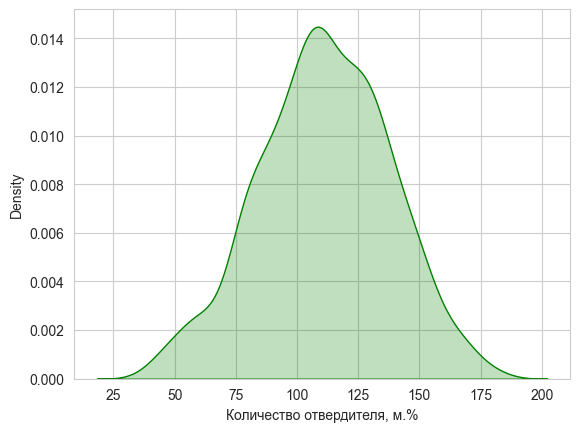

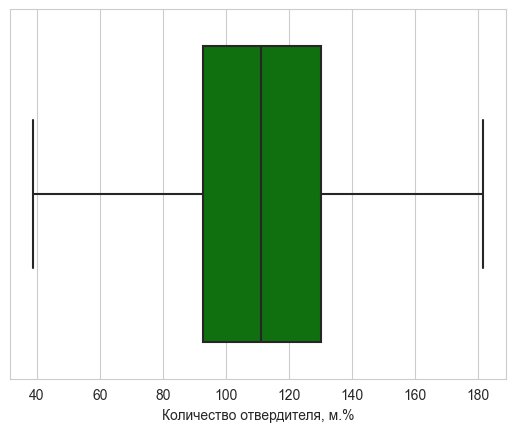

Минимальное значение:  38.6685003343557
Максимальное значение:  181.82844779488
Среднее значение:  111.13606551174503
Медианное значение:  111.16208958489



Содержание эпоксидных групп,%_2


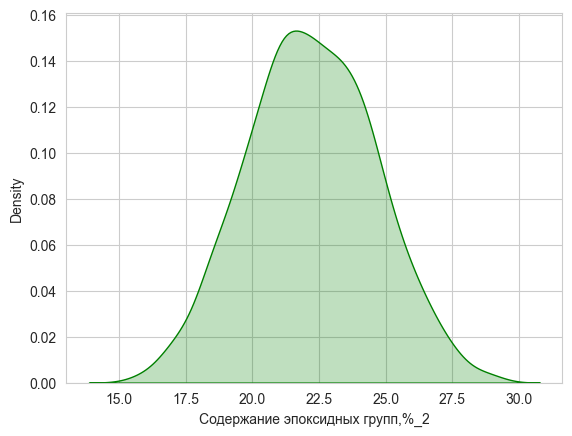

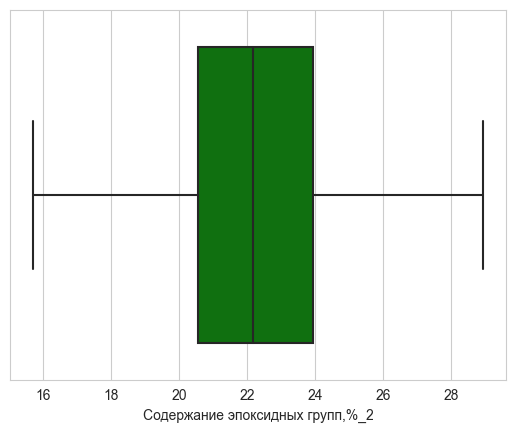

Минимальное значение:  15.6958938036288
Максимальное значение:  28.9550943746499
Среднее значение:  22.20056957552489
Медианное значение:  22.177680549474353



Температура вспышки, С_2


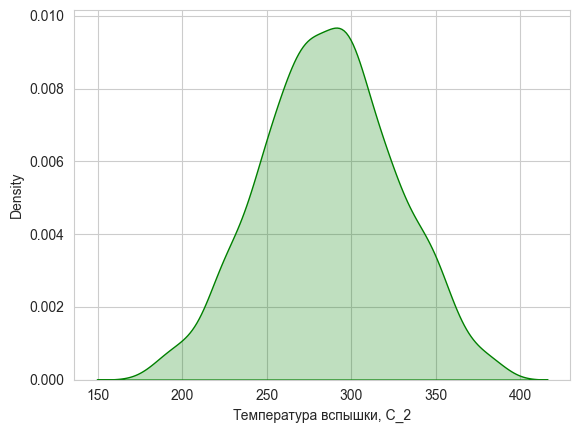

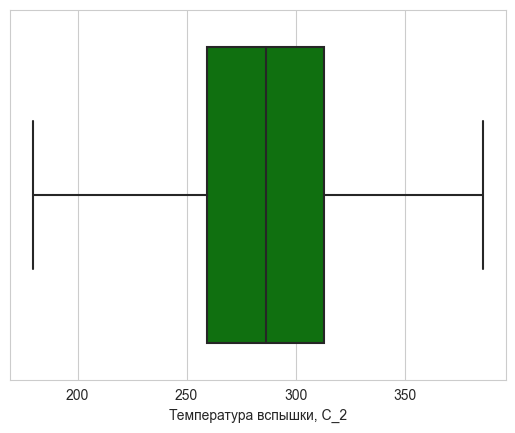

Минимальное значение:  179.37439137039
Максимальное значение:  386.067991779505
Среднее значение:  286.18112769571894
Медианное значение:  286.2207634450395



Поверхностная плотность, г/м2


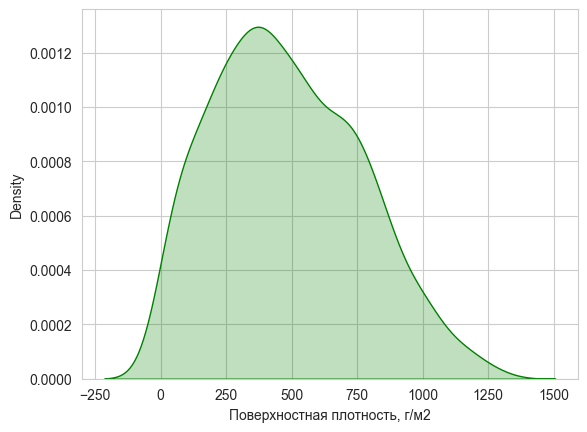

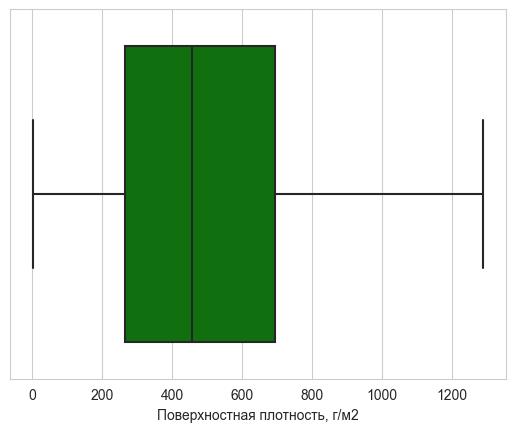

Минимальное значение:  0.603739925153945
Максимальное значение:  1291.34011463545
Среднее значение:  482.4290697625872
Медианное значение:  457.7322458016435



Модуль упругости при растяжении, ГПа


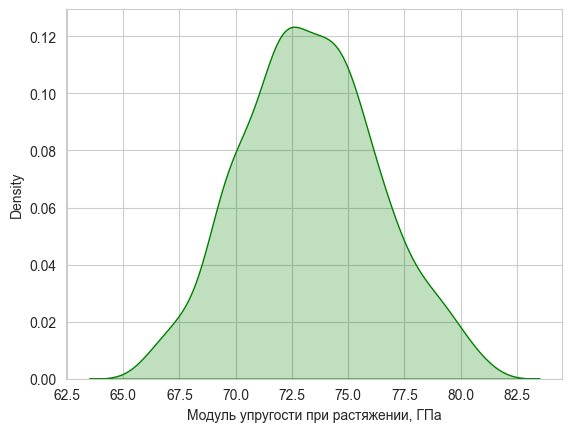

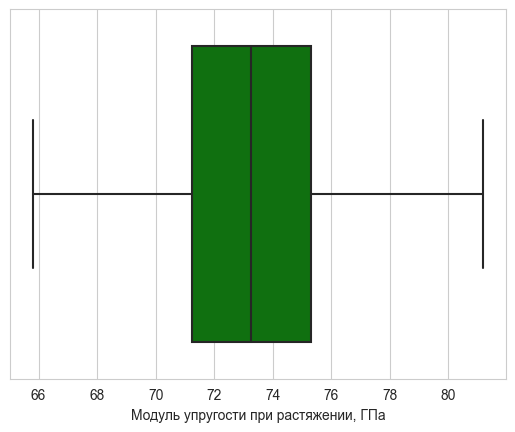

Минимальное значение:  65.7938449666054
Максимальное значение:  81.203146720828
Среднее значение:  73.30346431634351
Медианное значение:  73.24759433381435



Прочность при растяжении, МПа


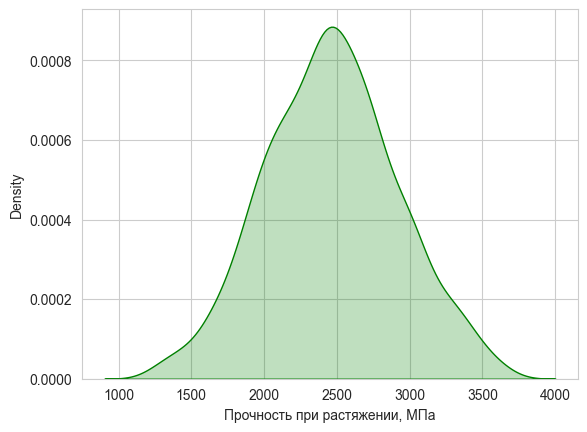

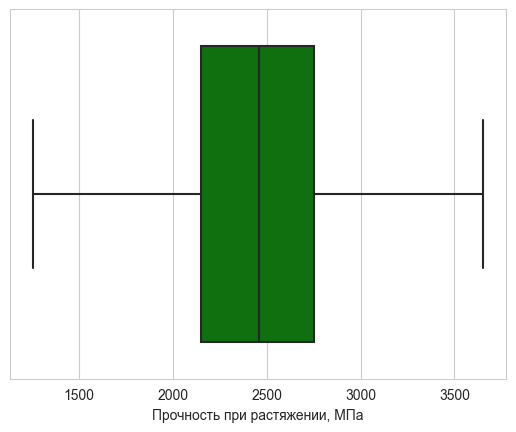

Минимальное значение:  1250.39280220501
Максимальное значение:  3654.43435901371
Среднее значение:  2461.491314888544
Медианное значение:  2455.9744618562454



Потребление смолы, г/м2


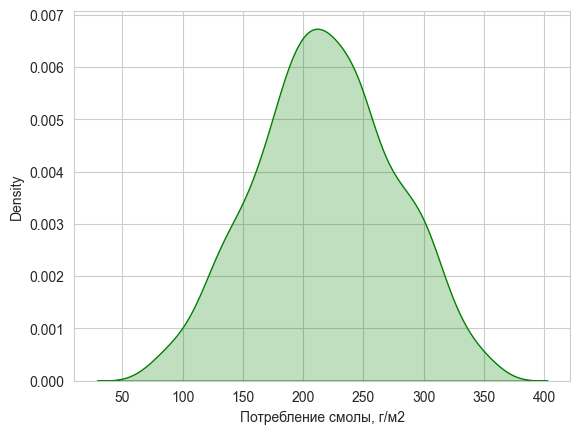

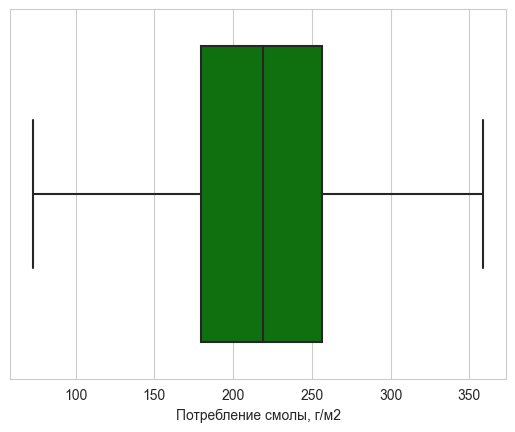

Минимальное значение:  72.5308733761696
Максимальное значение:  359.052219789673
Среднее значение:  218.04805926326966
Медианное значение:  218.697659676914



Угол нашивки


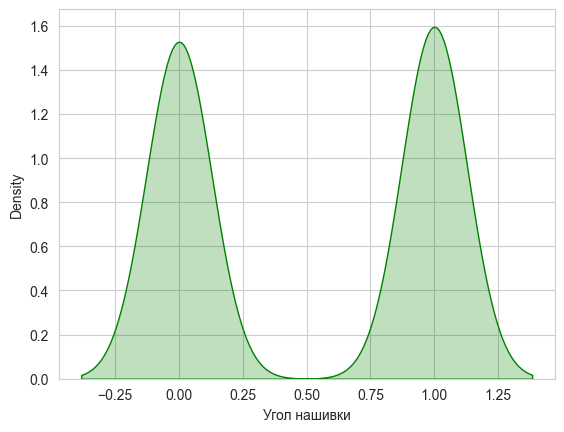

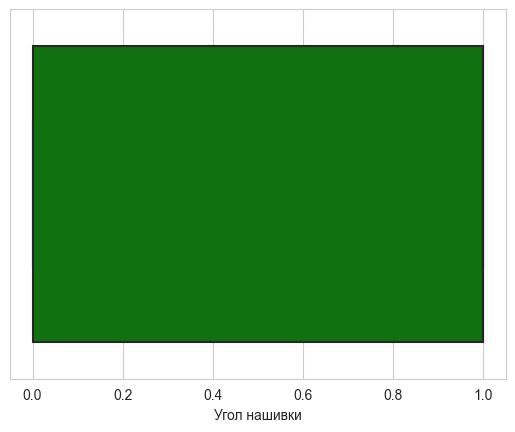

Минимальное значение:  0
Максимальное значение:  1
Среднее значение:  0.5108459869848156
Медианное значение:  1.0



Шаг нашивки


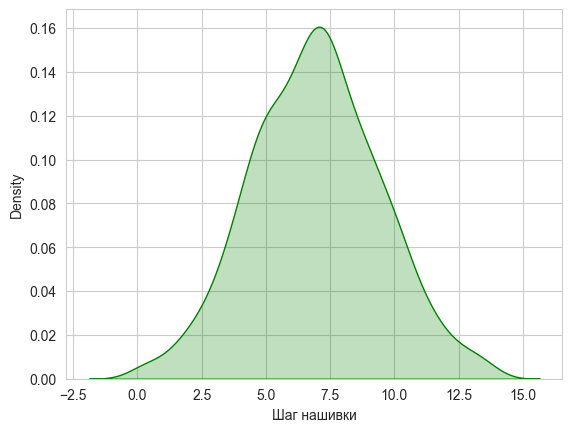

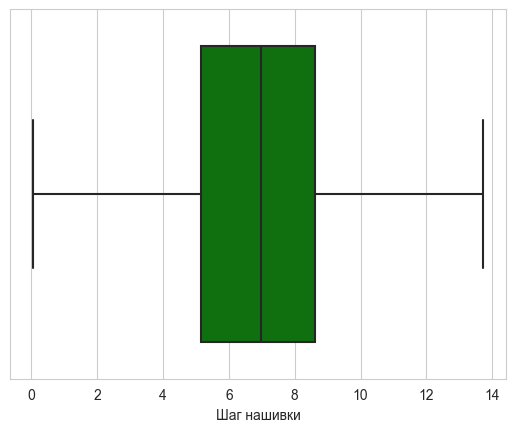

Минимальное значение:  0.0376389366987437
Максимальное значение:  13.732404403383
Среднее значение:  6.9319391914274275
Медианное значение:  6.972861915253585



Плотность нашивки


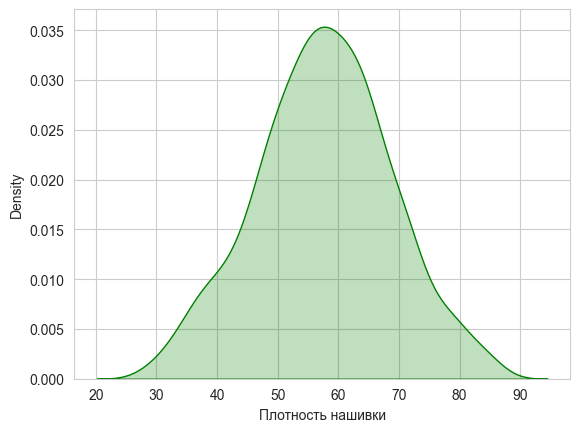

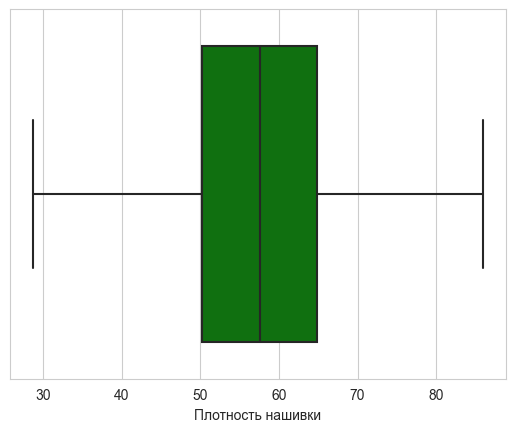

Минимальное значение:  28.6616316278123
Максимальное значение:  86.0124270098611
Среднее значение:  57.56288675591675
Медианное значение:  57.584224985771854





In [43]:
#часть кода выше не работает в колабе, поэтому выбросы проверим еще другими способами
for column_name in column_names:
  print(column_name)
    
    #Гистограмма распределения
  gis = df[column_name]
  sns.set_style("whitegrid")
  sns.kdeplot(data = gis, shade = True, palette = 'colorblind', color = "g")
  plt.show()
    
    #Диаграмма "Ящик с усами"
  sns.boxplot(x = gis, color = "g");
  plt.show()
    
    #Значения (мин макс ср)
  print("Минимальное значение: ", end = " ")
  print(np.min(gis))
  print("Максимальное значение: ", end = " ")
  print(np.max(gis))
  print("Среднее значение: ", end = " ")
  print(np.mean(gis))

  print("Медианное значение: ", end = " ")
  print(np.median(gis))
  print("\n\n")

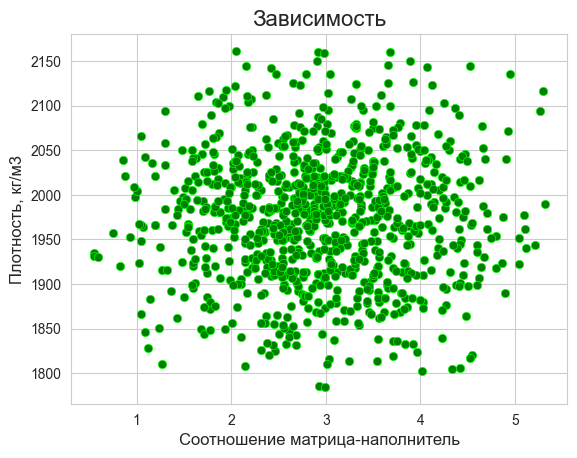

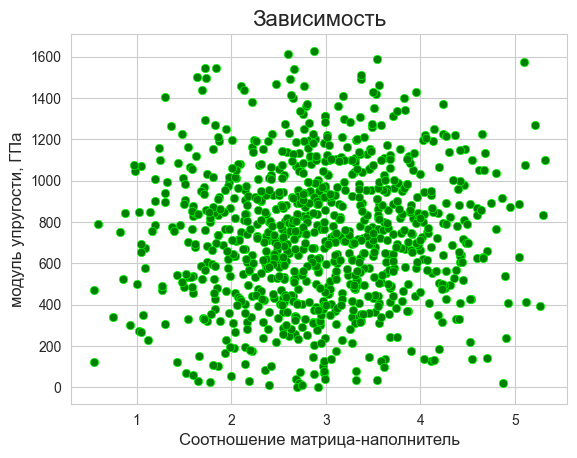

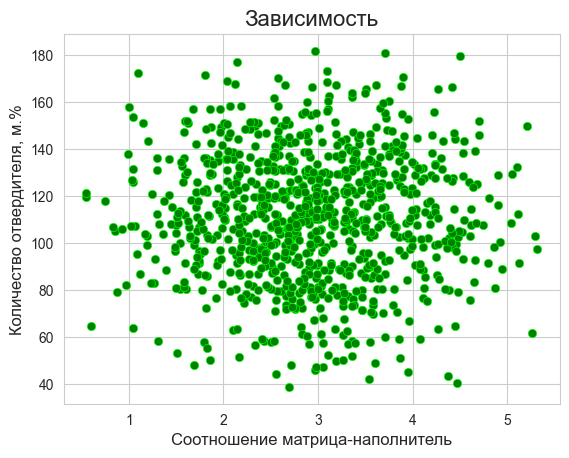

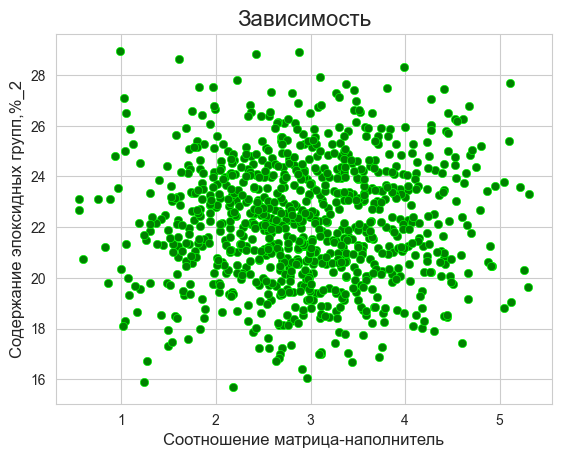

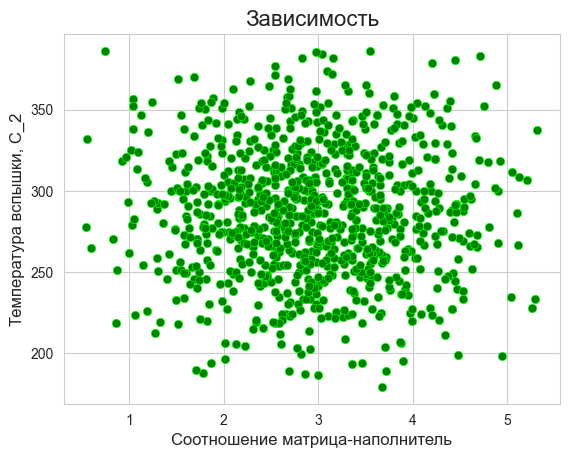

...

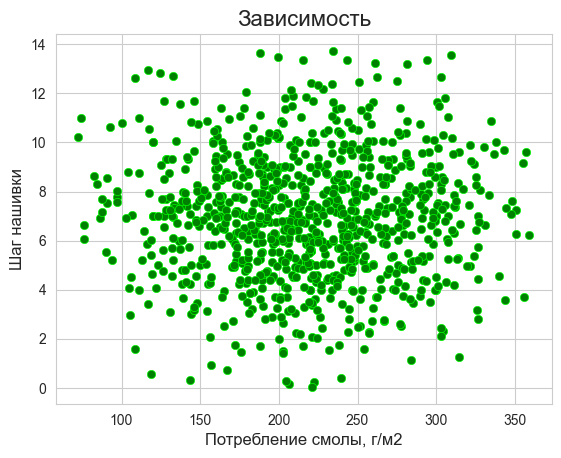

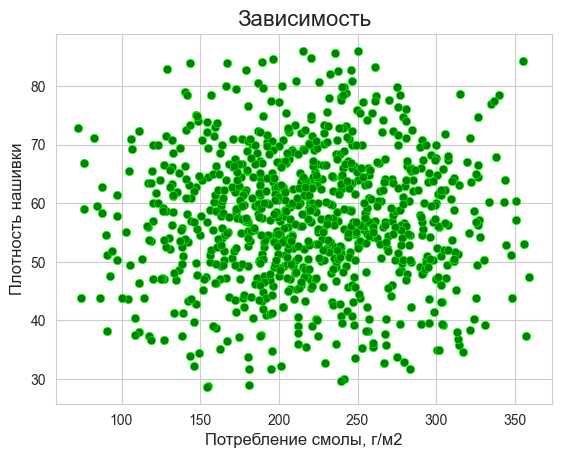

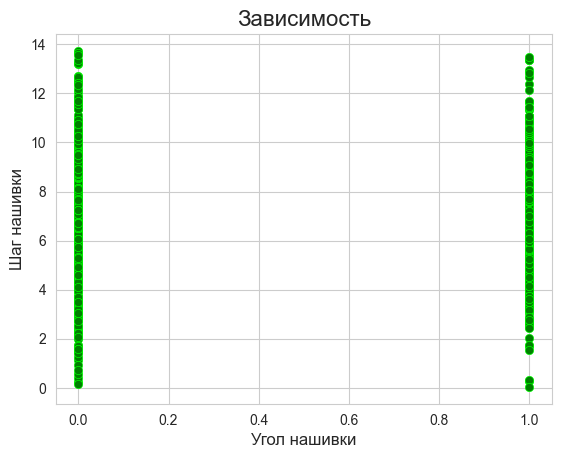

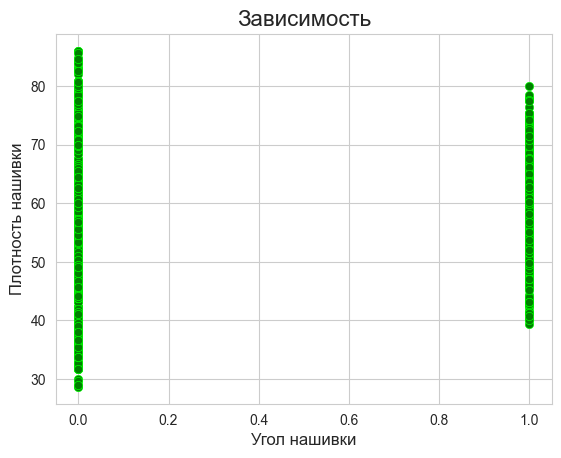

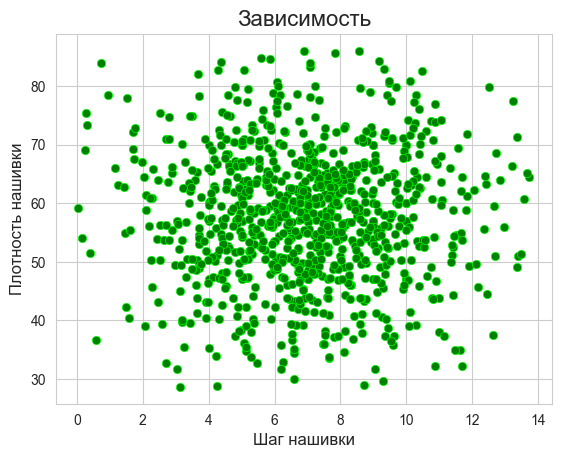

In [44]:
n = 0
while n < len(column_names):
    b = n + 1
    while b < len(column_names):
        sns.set_style('whitegrid')
        plt.title('Зависимость',size = 16)
        plt.xlabel(column_names[n],size = 12)
        plt.ylabel(column_names[b],size = 12)
        sns.scatterplot(x = column_names[n], y = column_names[b], data = df, color = "green", edgecolor = 'lime', palette = 'cubehelix')
        plt.show()
        b += 1
    n += 1

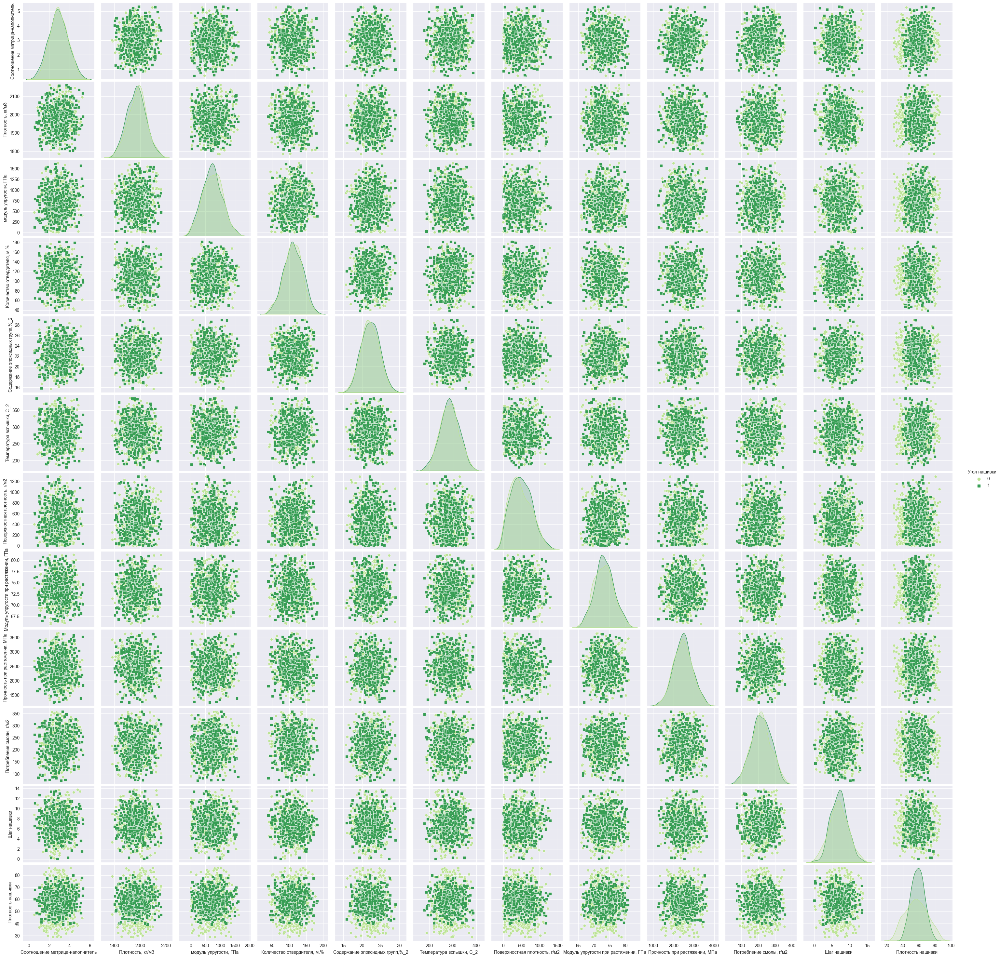

In [45]:
sns.set_style('darkgrid')
sns.pairplot(df, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

<function matplotlib.pyplot.show(close=None, block=None)>

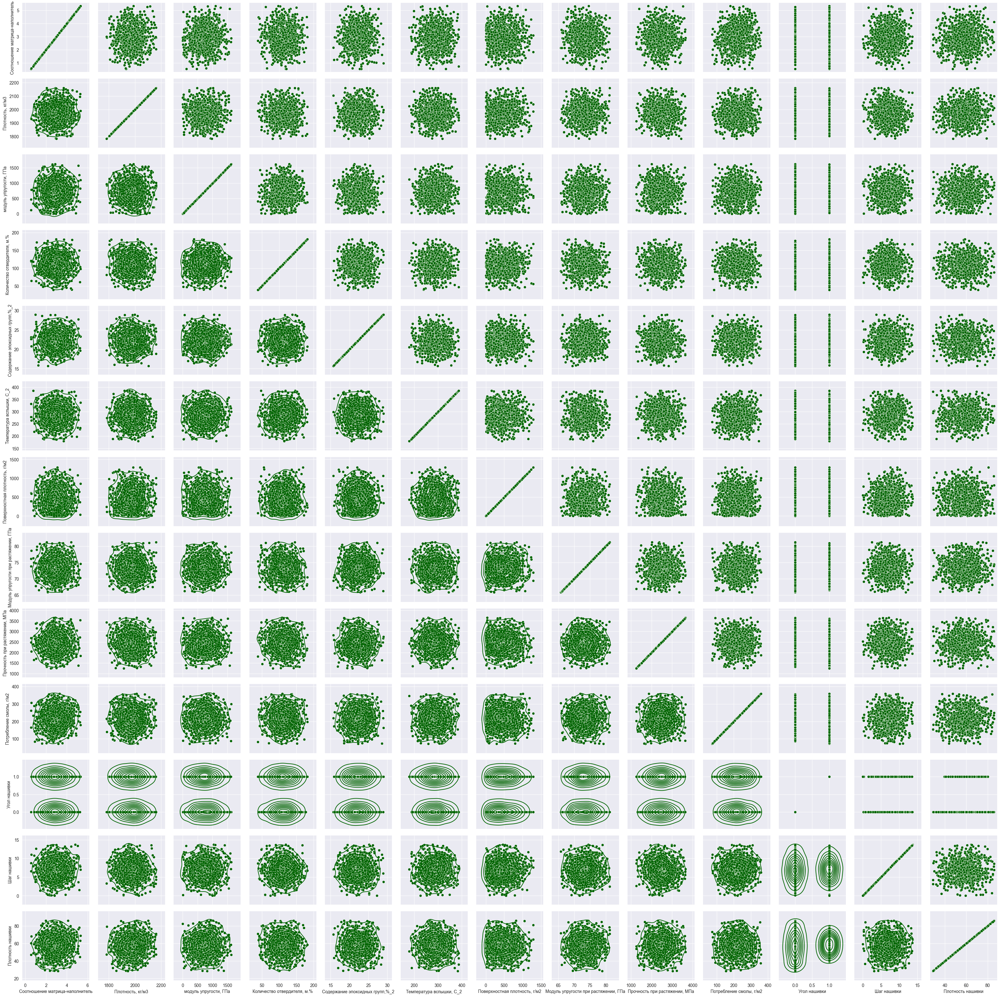

In [46]:
# Попарные графики рассеяния точек - скаттерплоты (второй вариант) 
g = sns.PairGrid(df[df.columns])
g.map(sns.scatterplot, color = 'darkgreen')
g.map_upper(sns.scatterplot, color = 'darkgreen')
g.map_lower(sns.kdeplot, color = 'darkgreen')
plt.show
# Корреляции нет

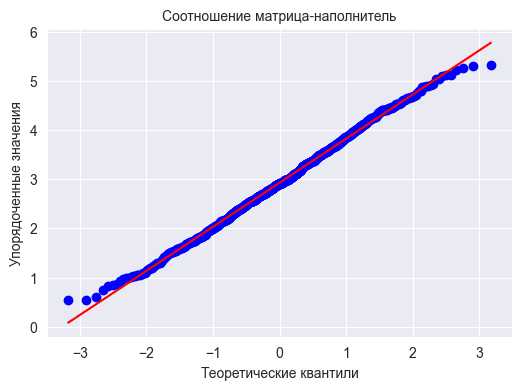

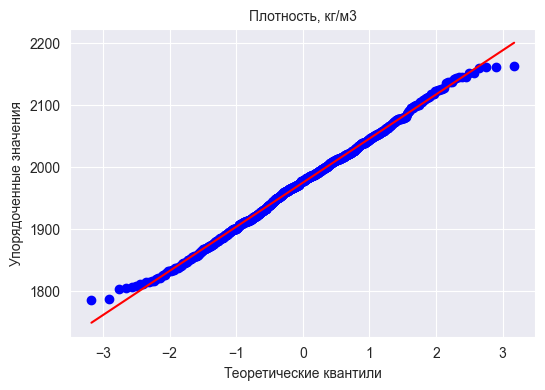

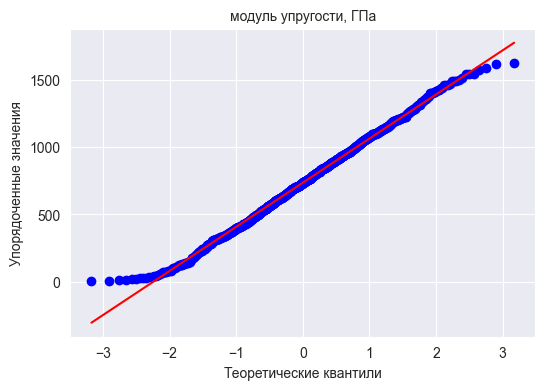

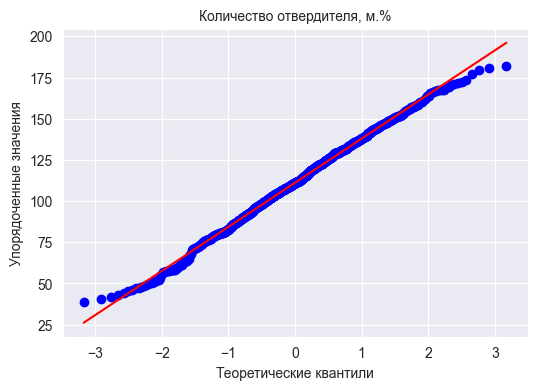

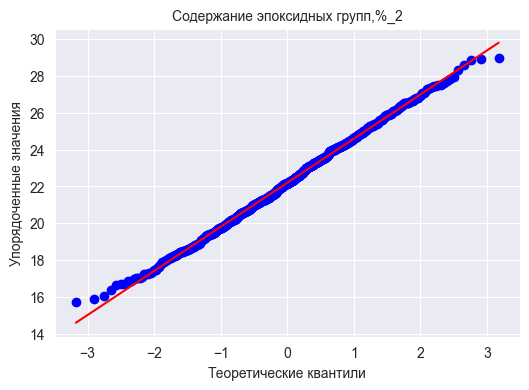

...

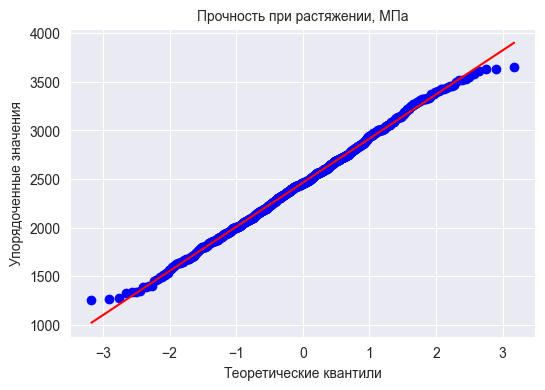

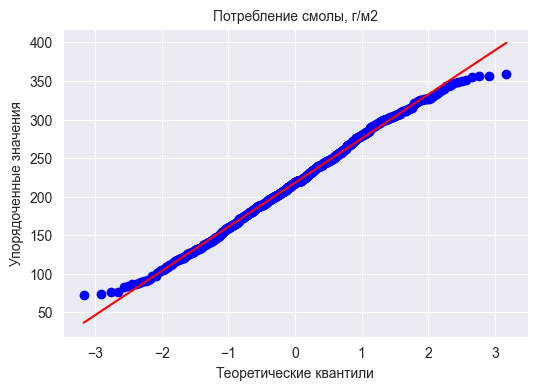

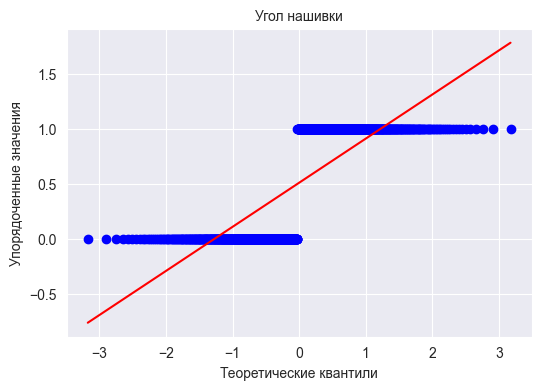

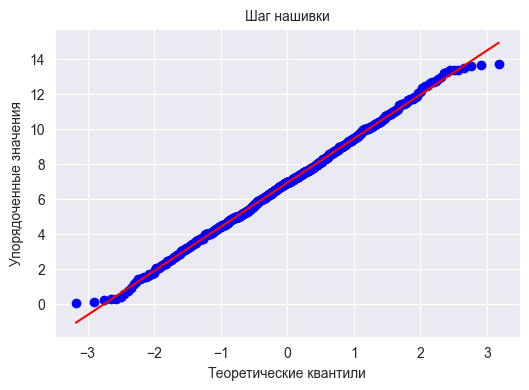

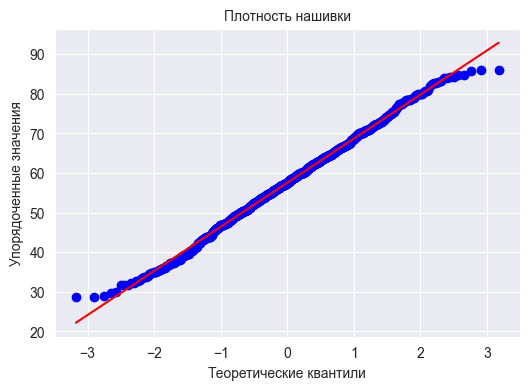

In [47]:
for i in df.columns:
    plt.figure(figsize = (6, 4))
    res = stats.probplot(df[i], plot = plt)
    plt.title(i, fontsize = 10)
    plt.xlabel("Теоретические квантили", fontsize = 10)
    plt.ylabel("Упорядоченные значения", fontsize = 10)
    plt.show()

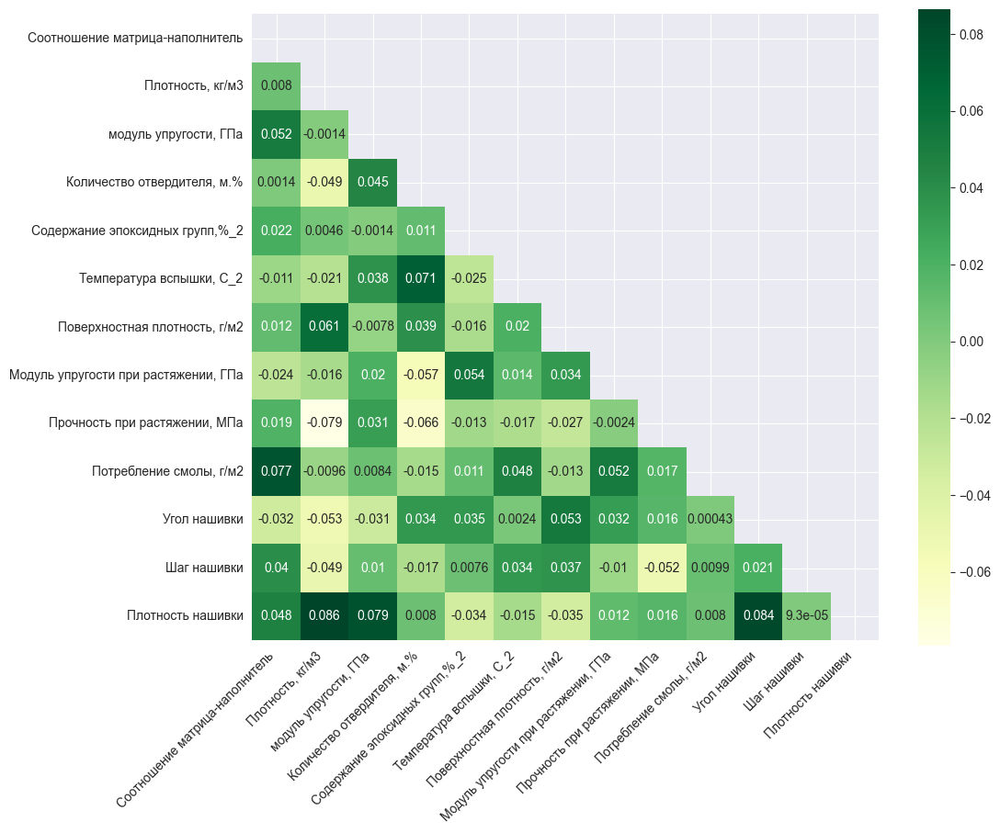

In [48]:
#Визуализация корреляционной матрицы с помощью тепловой карты
mask = np.triu(df.corr())
# Создаем полотно для отображения большого графика
f, ax = plt.subplots(figsize=(11, 9))
# # Визуализируем данные кореляции и создаем цветовую политру
sns.heatmap(df.corr(), mask = mask, annot = True, square = True, cmap = 'YlGn')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

In [49]:
# Уффф, наконец-то, убеждаемся, что выбросов не осталось. В итоге осталось всего 922 строки 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       922 non-null    float64
 1   Плотность, кг/м3                      922 non-null    float64
 2   модуль упругости, ГПа                 922 non-null    float64
 3   Количество отвердителя, м.%           922 non-null    float64
 4   Содержание эпоксидных групп,%_2       922 non-null    float64
 5   Температура вспышки, С_2              922 non-null    float64
 6   Поверхностная плотность, г/м2         922 non-null    float64
 7   Модуль упругости при растяжении, ГПа  922 non-null    float64
 8   Прочность при растяжении, МПа         922 non-null    float64
 9   Потребление смолы, г/м2               922 non-null    float64
 10  Угол нашивки                          922 non-null    int64  
 11  Шаг нашивки       

In [50]:
#Сохраняем идеальный, без выбросов датасет, чтобы в excel проверить дополнительно
df.to_csv('Itog\Itog.csv', encoding = 'cp1251' )
df.to_excel("Itog\Itog.xlsx")

In [51]:
#Проводим повторный разведочный анализ уже без выбросов

In [52]:
#Выведем корреляции между параметрами
df.corr()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311
"Потребление смолы, г/м2",0.076857,-0.009609,0.008368,-0.014827,0.010808,0.048142,-0.012606,0.051676,0.016753,1.000000,0.000433,0.009932,0.008012


In [53]:
# Посмотрим на средние и медианные знчения датасета после выбросов 
mean_and_50 = df.describe()
mean_and_50.loc[['mean', '50%']]
# Убедимся, что после удаления выбросов среднее и медианное значение остались в пределах предыдущих значений

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
mean,2.927964,1974.118744,736.119982,111.136066,22.200570,286.181128,482.429070,73.303464,2461.491315,218.048059,0.510846,6.931939,57.562887
50%,2.907832,1977.321002,736.178435,111.162090,22.177681,286.220763,457.732246,73.247594,2455.974462,218.697660,1.000000,6.972862,57.584225


Приготовим переменные и проверим данные перед нормализацией данных

In [54]:
df_norm = df.copy()

In [55]:
df_norm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       922 non-null    float64
 1   Плотность, кг/м3                      922 non-null    float64
 2   модуль упругости, ГПа                 922 non-null    float64
 3   Количество отвердителя, м.%           922 non-null    float64
 4   Содержание эпоксидных групп,%_2       922 non-null    float64
 5   Температура вспышки, С_2              922 non-null    float64
 6   Поверхностная плотность, г/м2         922 non-null    float64
 7   Модуль упругости при растяжении, ГПа  922 non-null    float64
 8   Прочность при растяжении, МПа         922 non-null    float64
 9   Потребление смолы, г/м2               922 non-null    float64
 10  Угол нашивки                          922 non-null    int64  
 11  Шаг нашивки       


### Предобработка данных.
Нормализуем данные

У нас в основном количественные признаки, поэтому можно применить нормализацию (приведение в диапазон от 0 до 1) или стандартизацию (приведение к матожиданию 0, стандартному отклонению 1). Т.к. это в том числе учебная работа, то используем и нормализацию, и стандартизацию. 

Этап предобработки данных нужен нам и для введенных данных в будущем приложении, которое явится результатом нашей работы. 

<Axes: ylabel='Density'>

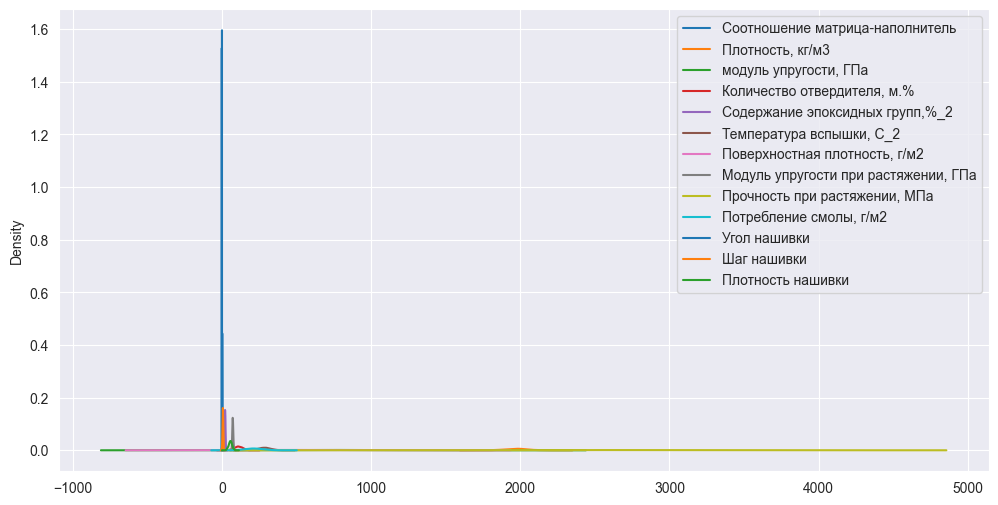

In [56]:
# На данный момент в нашем датасете всего 922 строки. Они все без выбросов, пропущенных значений, все имеют int или float. 
fig, ax = plt.subplots(figsize = (12, 6))
df_norm.plot(kind = 'kde', ax = ax)
# Оценка плотности ядра показывает, что наши данные находятся в разных диапазонах. А в связи с тем, что диапазоны очень разные, данные нужно нормализовать. Можем приступать к нормализации данных.

In [57]:
#Нормализуем данные с помощью MinMaxScaler() 
scaler = preprocessing.MinMaxScaler()
col = df.columns
result = scaler.fit_transform(df)

df_minmax_n = pd.DataFrame(result, columns = col)
df_minmax_n.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


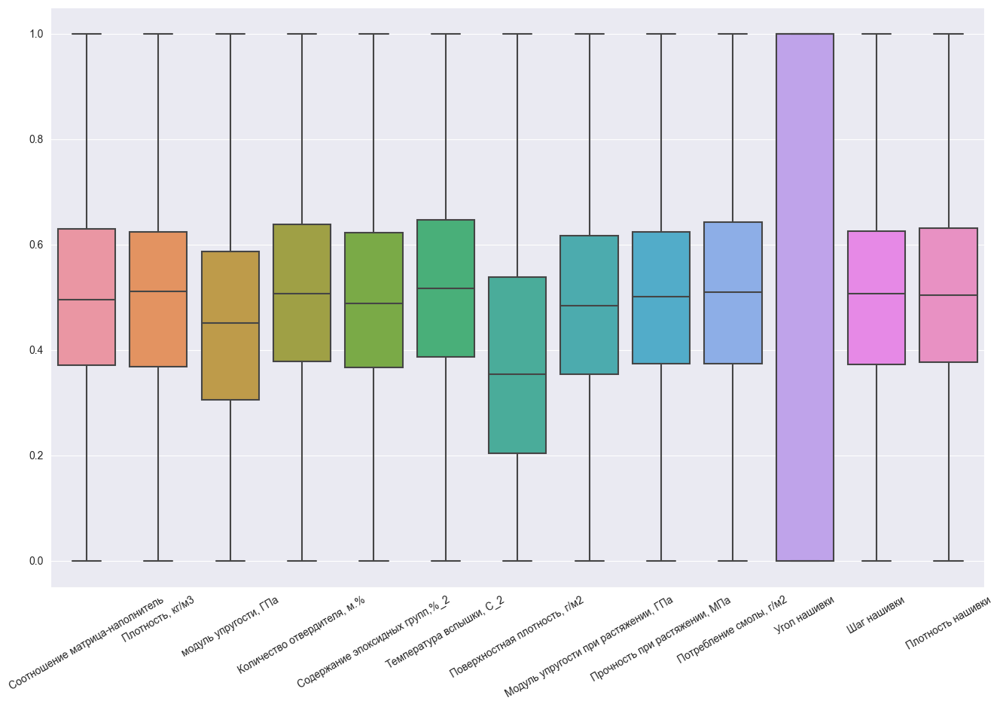

In [58]:
plt.figure(figsize = (16,10))
ax = sns.boxplot(data = df_minmax_n)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<Axes: ylabel='Density'>

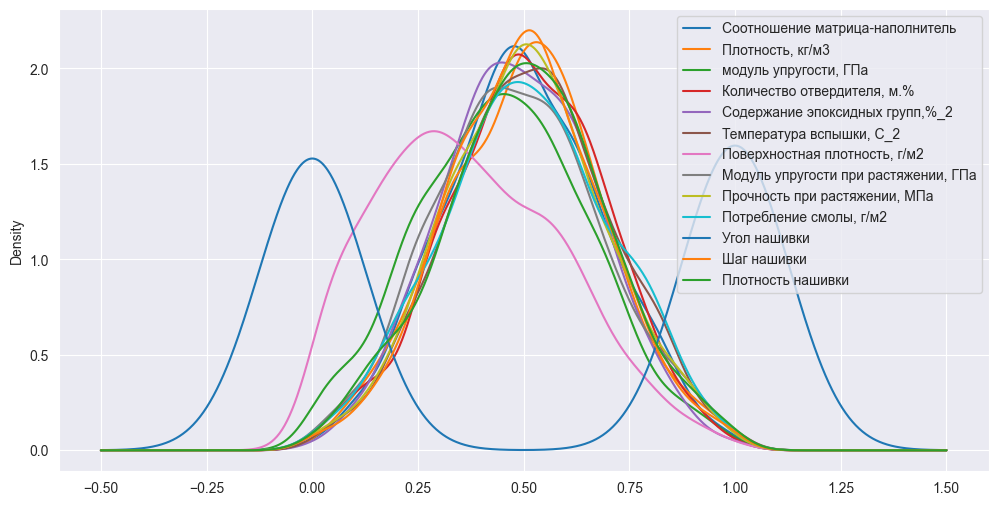

In [59]:
fig, ax = plt.subplots(figsize = (12, 6))
df_minmax_n.plot(kind = 'kde', ax = ax)

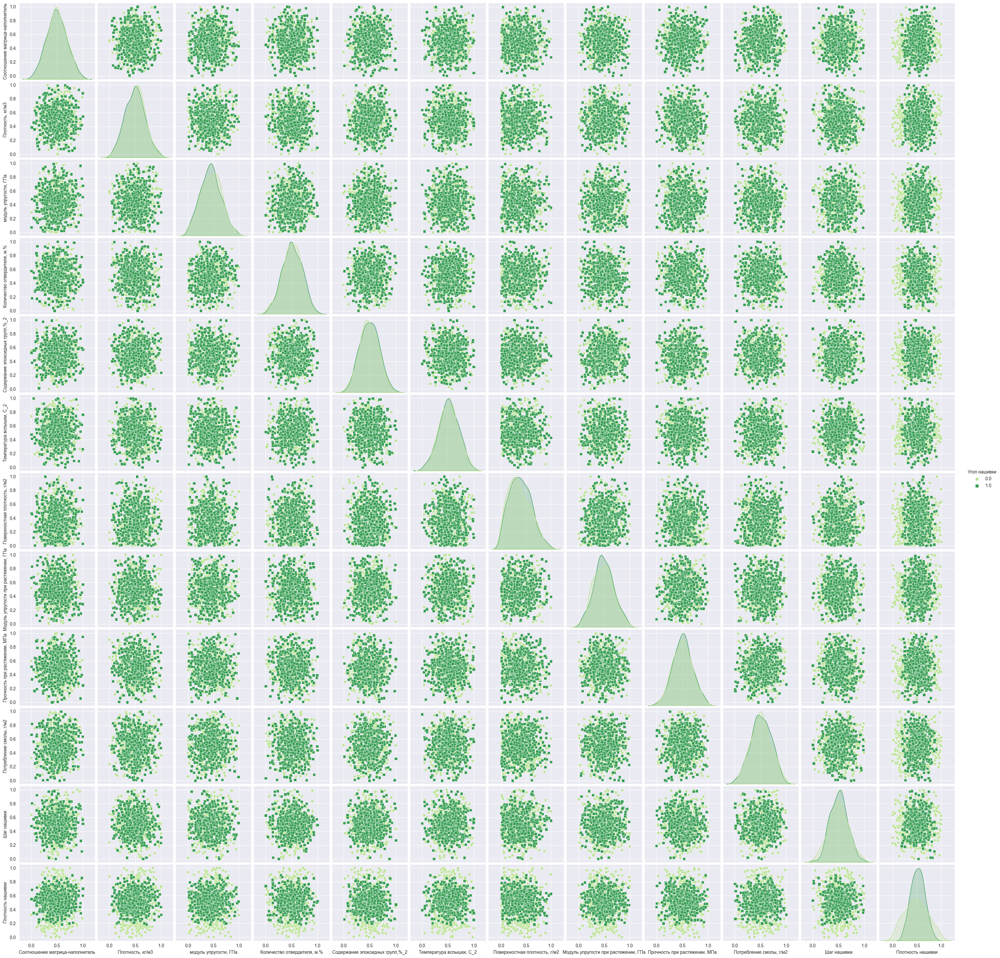

In [60]:
sns.pairplot(df_minmax_n, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

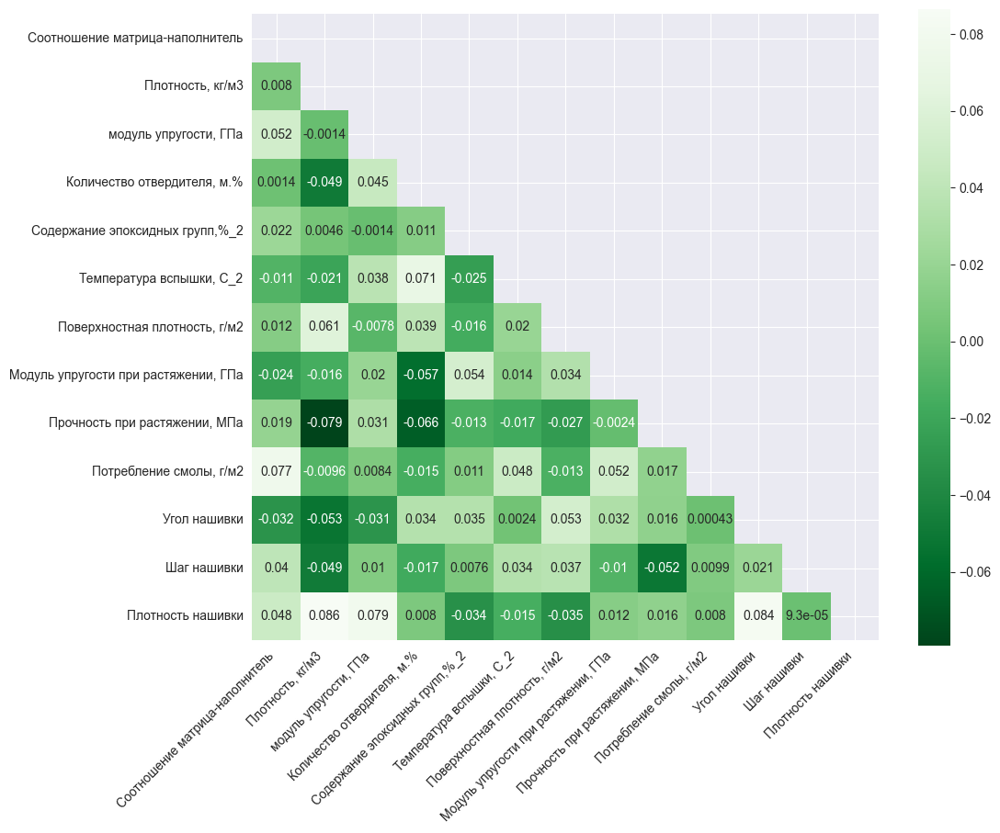

In [61]:
mask = np.triu(df_minmax_n.corr())
f, ax = plt.subplots(figsize = (11, 9))
sns.heatmap(df_minmax_n.corr(), mask = mask, annot = True, square = True, cmap = 'Greens_r')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

In [62]:
#Нормализуем данные с помощью Normalizer()

normalizer = Normalizer()
res = normalizer.fit_transform(df)
df_norm_n = pd.DataFrame(res, columns = df.columns)
df_norm_n

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805167,0.059046,0.000000,0.001342,0.015298
3,0.000746,0.539271,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808906,0.059320,0.000000,0.001348,0.016178
4,0.000699,0.519919,0.219673,0.030449,0.006062,0.077475,0.057164,0.019055,0.816627,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.000700,0.601751,0.281397,0.026816,0.006203,0.100115,0.064488,0.022531,0.735908,0.038535,0.000308,0.002798,0.014494
918,0.001078,0.641795,0.139227,0.045701,0.006136,0.079584,0.109777,0.022828,0.738938,0.036856,0.000313,0.003308,0.016827
919,0.000953,0.573123,0.121122,0.032118,0.006961,0.072186,0.215067,0.021716,0.773775,0.068752,0.000291,0.001209,0.019652
920,0.001192,0.664667,0.238453,0.045473,0.006190,0.088689,0.206291,0.023812,0.666248,0.063394,0.000322,0.002030,0.018736


<Axes: ylabel='Density'>

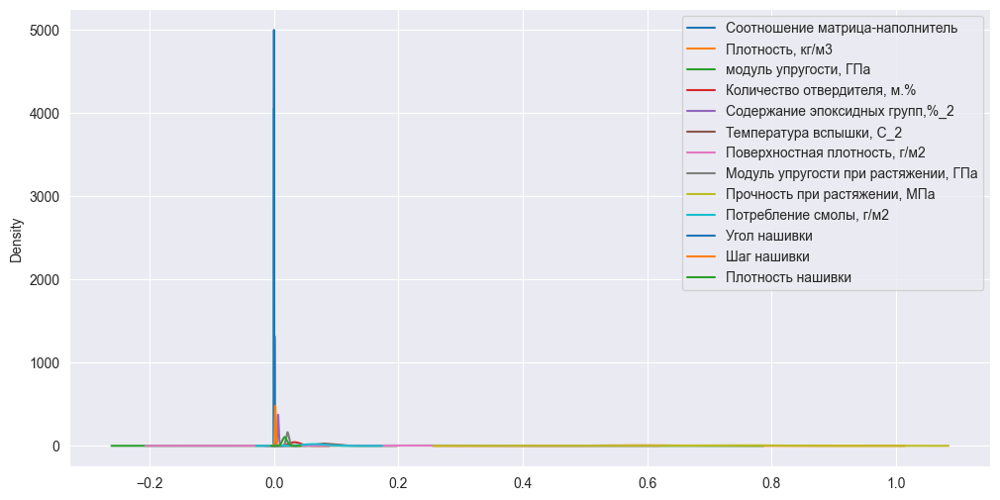

In [63]:
fig, ax = plt.subplots(figsize = (12, 6))
df_norm_n.plot(kind = 'kde', ax = ax)

In [64]:
#Сравним с данными до нормализации
df.head(10)

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0
5,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,60.0
6,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,70.0
7,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0,7.0,47.0
8,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0,7.0,57.0
9,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,60.0
10,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,70.0
11,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,9.0,47.0


In [65]:
# Проверяем перевод данных из нормализованных в исходные
col = df_minmax_n.columns
result_reverse = scaler.inverse_transform(df_minmax_n)
initial_data = pd.DataFrame(result_reverse, columns = col)
initial_data.head(10)

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0.0,4.0,60.0
1,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0.0,5.0,47.0
2,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,57.0
3,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,60.0
4,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,70.0
5,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0.0,7.0,47.0
6,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0.0,7.0,57.0
7,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,60.0
8,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,70.0
9,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,9.0,47.0


In [66]:
#Рассмотрим несколько вариантов корреляции между параметрами после нормализации (первый вариант)
df_norm_n[df_norm_n.columns].corr()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,0.281512,0.032460,0.137378,0.221541,0.180002,0.025513,0.262013,-0.257978,0.157659,-0.010611,0.136843,0.175839
"Плотность, кг/м3",0.281512,1.000000,-0.042233,0.390253,0.658281,0.564884,0.067392,0.875269,-0.837849,0.314219,0.082452,0.291974,0.445379
"модуль упругости, ГПа",0.032460,-0.042233,1.000000,0.049364,-0.028060,0.003038,-0.026006,-0.026914,-0.386917,-0.009529,-0.039522,0.002268,0.044303
"Количество отвердителя, м.%",0.137378,0.390253,0.049364,1.000000,0.305395,0.311569,0.067273,0.376425,-0.379828,0.143166,0.064597,0.121374,0.203167
"Содержание эпоксидных групп,%_2",0.221541,0.658281,-0.028060,0.305395,1.000000,0.404877,0.027470,0.660206,-0.551282,0.244822,0.098492,0.236752,0.280886
"Температура вспышки, С_2",0.180002,0.564884,0.003038,0.311569,0.404877,1.000000,0.038395,0.563793,-0.509841,0.246410,0.063124,0.216858,0.260809
"Поверхностная плотность, г/м2",0.025513,0.067392,-0.026006,0.067273,0.027470,0.038395,1.000000,0.055252,-0.318775,0.007772,0.043869,0.065979,-0.017402
"Модуль упругости при растяжении, ГПа",0.262013,0.875269,-0.026914,0.376425,0.660206,0.563793,0.055252,1.000000,-0.741163,0.328966,0.109996,0.302476,0.416465
"Прочность при растяжении, МПа",-0.257978,-0.837849,-0.386917,-0.379828,-0.551282,-0.509841,-0.318775,-0.741163,1.000000,-0.282606,-0.058592,-0.279843,-0.379346
"Потребление смолы, г/м2",0.157659,0.314219,-0.009529,0.143166,0.244822,0.246410,0.007772,0.328966,-0.282606,1.000000,0.033128,0.116685,0.140756


In [67]:
#Рассмотрим второй вариант корреляции между параметрами после нормализации (второй вариант)
df_minmax_n[df_minmax_n.columns].corr()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311
"Потребление смолы, г/м2",0.076857,-0.009609,0.008368,-0.014827,0.010808,0.048142,-0.012606,0.051676,0.016753,1.000000,0.000433,0.009932,0.008012


In [68]:
df_minmax_n

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.274768,0.651097,0.452951,0.079153,0.607435,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.289334,0.546433
1,0.274768,0.651097,0.452951,0.630983,0.418887,0.583596,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.319758
2,0.466552,0.651097,0.461725,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.494123
3,0.465836,0.571539,0.458649,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.546433
4,0.424236,0.332865,0.494944,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.720799
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.361662,0.444480,0.560064,0.337550,0.333908,0.703458,0.161609,0.473553,0.472912,0.183151,1.0,0.660014,0.320103
918,0.607674,0.704373,0.272088,0.749605,0.294428,0.362087,0.271207,0.462512,0.461722,0.157752,1.0,0.768759,0.437468
919,0.573391,0.498274,0.254927,0.501991,0.623085,0.334063,0.572959,0.580201,0.587558,0.572648,1.0,0.301102,0.679468
920,0.662497,0.748688,0.454635,0.717585,0.267818,0.466417,0.496511,0.535317,0.341643,0.434855,1.0,0.458245,0.516112


In [69]:
df_norm_n

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805167,0.059046,0.000000,0.001342,0.015298
3,0.000746,0.539271,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808906,0.059320,0.000000,0.001348,0.016178
4,0.000699,0.519919,0.219673,0.030449,0.006062,0.077475,0.057164,0.019055,0.816627,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.000700,0.601751,0.281397,0.026816,0.006203,0.100115,0.064488,0.022531,0.735908,0.038535,0.000308,0.002798,0.014494
918,0.001078,0.641795,0.139227,0.045701,0.006136,0.079584,0.109777,0.022828,0.738938,0.036856,0.000313,0.003308,0.016827
919,0.000953,0.573123,0.121122,0.032118,0.006961,0.072186,0.215067,0.021716,0.773775,0.068752,0.000291,0.001209,0.019652
920,0.001192,0.664667,0.238453,0.045473,0.006190,0.088689,0.206291,0.023812,0.666248,0.063394,0.000322,0.002030,0.018736


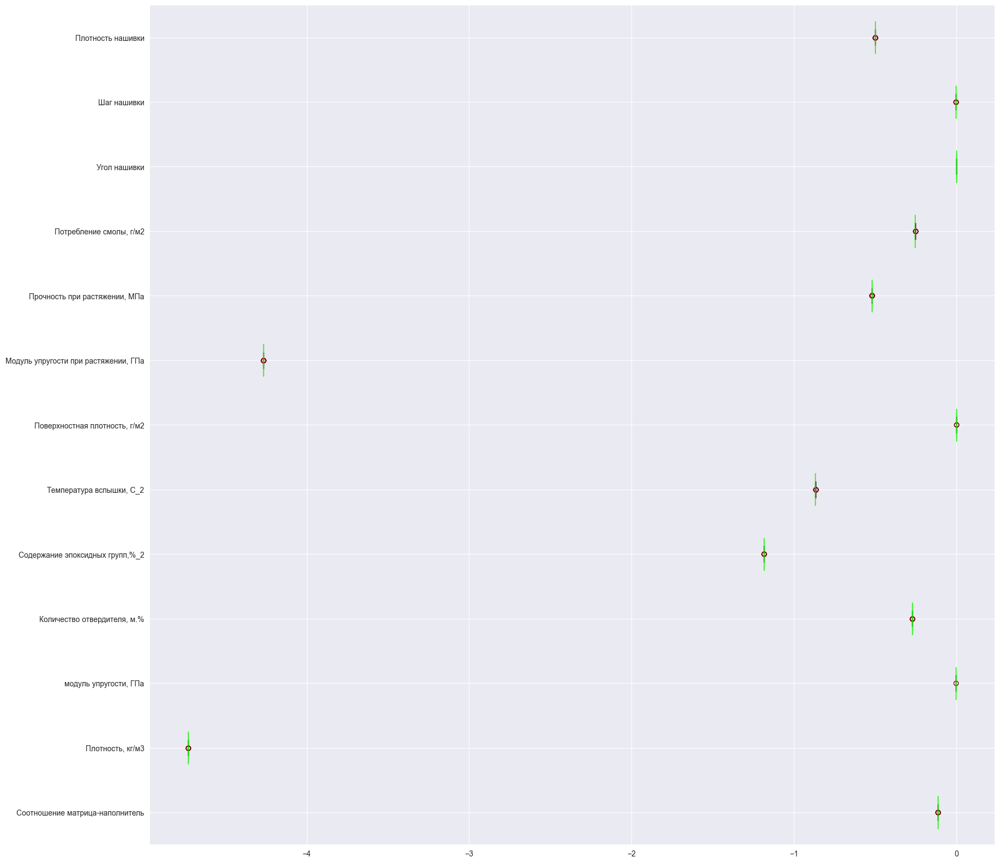

In [70]:
#Построим на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize=(20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df_norm_n)), labels = df_norm_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


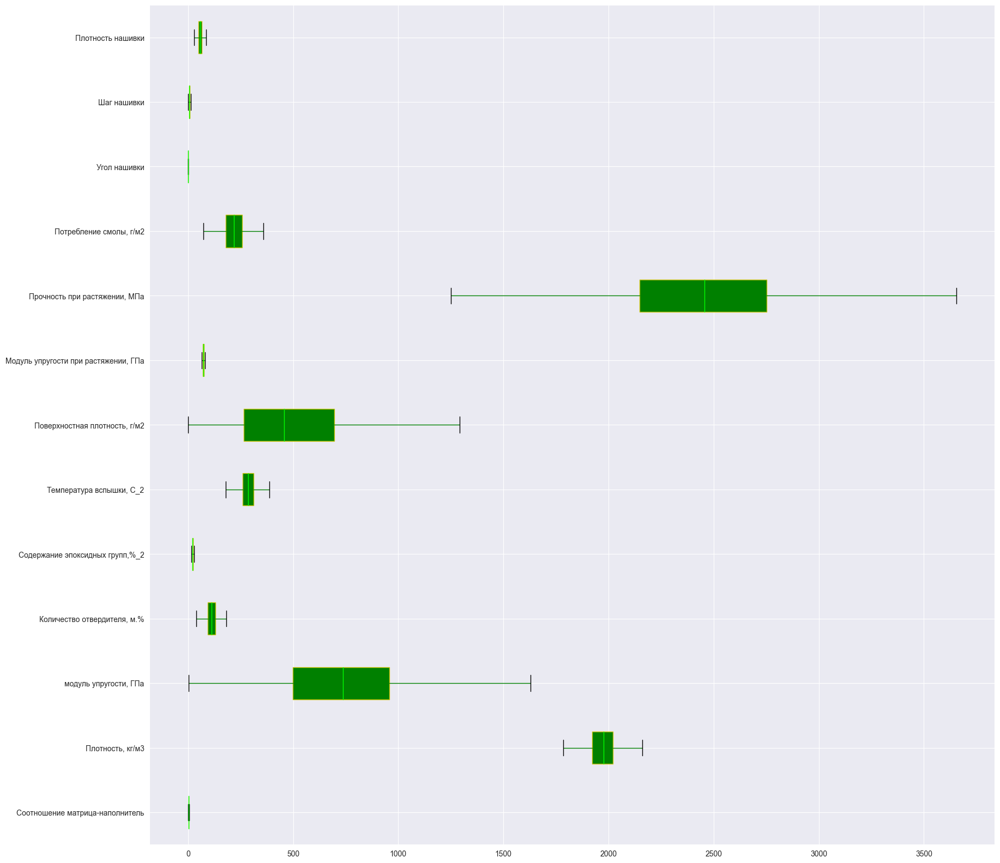

In [71]:
#Попытаемся посмотреть на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df_minmax_n)
plt.figure(figsize = (20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df_minmax_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


In [72]:
# Визуализация графиков показывает, что нормализация при помощи "Normalizer" дает нам большое количество выбросов

### Стандартизируем данные

In [73]:
X1 = df_minmax_n.copy()
X2 = df_norm_n.copy()

In [74]:
df_std_X1 = preprocessing.StandardScaler().fit(X1)
df_standart_X1 = df_std_X1.transform(X1)
df_standart_1 = pd.DataFrame(df_standart_X1)

<Axes: ylabel='Density'>

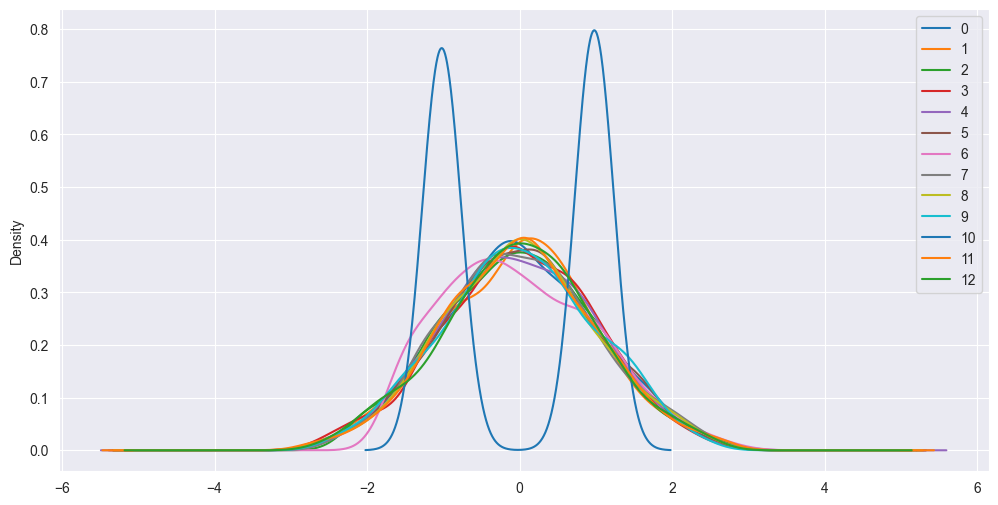

In [75]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_1.plot(kind = 'kde', ax = ax)

In [76]:
df_standart_1

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,-1.196467,0.787037,0.007992,-2.286425,0.647585,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-1.166792,0.219240
1,-1.196467,0.787037,0.007992,0.668092,-0.397291,0.350738,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.950227
2,-0.175012,0.787037,0.051553,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.050637
3,-0.178825,0.364514,0.036283,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,0.219240
4,-0.400390,-0.903054,0.216474,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,1.118831
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,-0.733662,-0.310284,0.539767,-0.902956,-0.868217,0.979545,-0.974830,-0.070267,-0.163679,-1.629244,0.978538,0.853400,-0.948449
918,0.576611,1.069974,-0.889924,1.303201,-1.087006,-0.811326,-0.470122,-0.126524,-0.223019,-1.756683,0.978538,1.446055,-0.342933
919,0.394018,-0.024589,-0.975122,-0.022536,0.734311,-0.958342,0.919470,0.473140,0.444312,0.324984,0.978538,-1.102660,0.905599
920,0.868603,1.305328,0.016356,1.131763,-1.234469,-0.263996,0.567419,0.244441,-0.859827,-0.366368,0.978538,-0.246233,0.062808


In [77]:
df_std_X2 = preprocessing.StandardScaler().fit(X2)
df_standart_X2 = df_std_X2.transform(X2)
df_standart_2 = pd.DataFrame(df_standart_X2)

<Axes: ylabel='Density'>

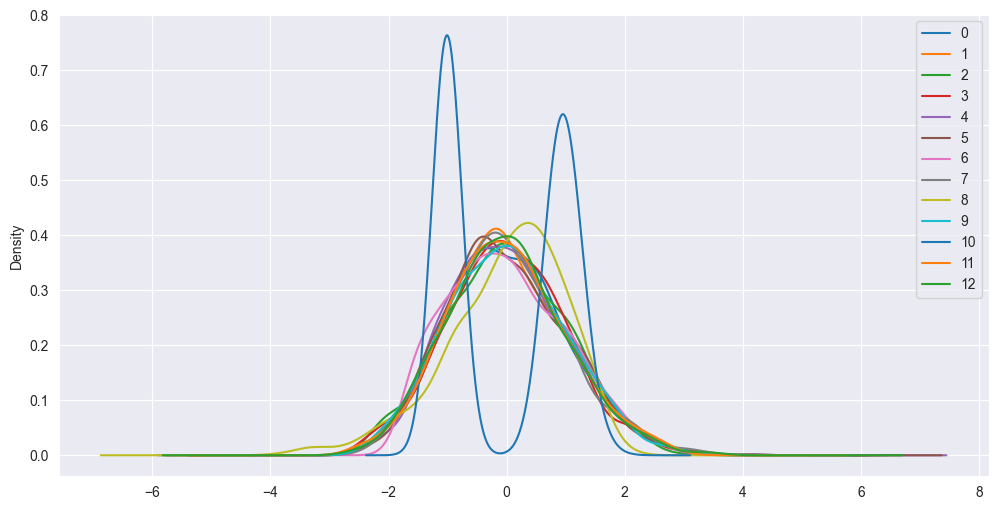

In [78]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_2.plot(kind = 'kde', ax=ax)

In [79]:
df_standart_2

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,-1.350498,-0.800587,-0.225645,-2.254951,-0.330124,-0.671638,-1.055275,-1.355362,1.083430,-0.367448,-1.010316,-1.270050,-0.337462
1,-1.351860,-0.807188,-0.227264,0.108938,-0.995822,-0.400917,-1.055800,-1.361270,1.074341,-0.369941,-1.010316,-0.938747,-1.261078
2,-0.493829,-0.810003,-0.187937,-0.405305,-0.728743,-0.677298,-1.056024,-1.363790,1.070465,-0.371004,-1.010316,-0.939301,-0.554499
3,-0.484962,-0.896227,-0.192219,-0.389758,-0.701418,-0.653706,-1.052902,-1.328659,1.124504,-0.356180,-1.010316,-0.931586,-0.322473
4,-0.648927,-1.196396,-0.004208,-0.357656,-0.644997,-0.604992,-1.046455,-1.256122,1.236081,-0.325573,-1.010316,-0.915657,0.436003
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,-0.646503,0.072936,0.641033,-0.762769,-0.505500,0.900672,-0.959086,0.143638,0.069576,-1.479779,1.005415,0.862968,-0.766453
918,0.676313,0.694067,-0.845152,1.342997,-0.571810,-0.464729,-0.418815,0.263359,0.113365,-1.570525,1.036781,1.493975,-0.151358
919,0.239190,-0.371131,-1.034407,-0.171548,0.241010,-0.956746,0.837232,-0.184553,0.616810,0.153718,0.889772,-1.103709,0.593392
920,1.073279,1.048848,0.192114,1.317553,-0.518818,0.140773,0.732541,0.659236,-0.937103,-0.135918,1.092595,-0.087233,0.352074


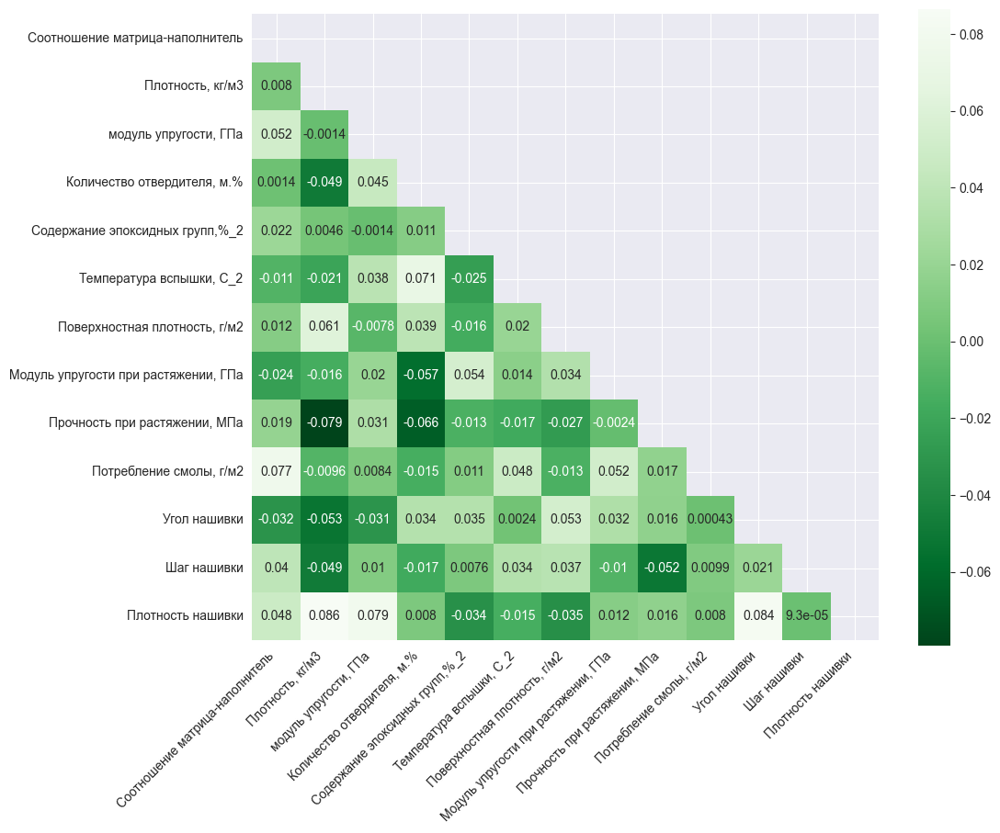

In [80]:
mask = np.triu(X1.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X1.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

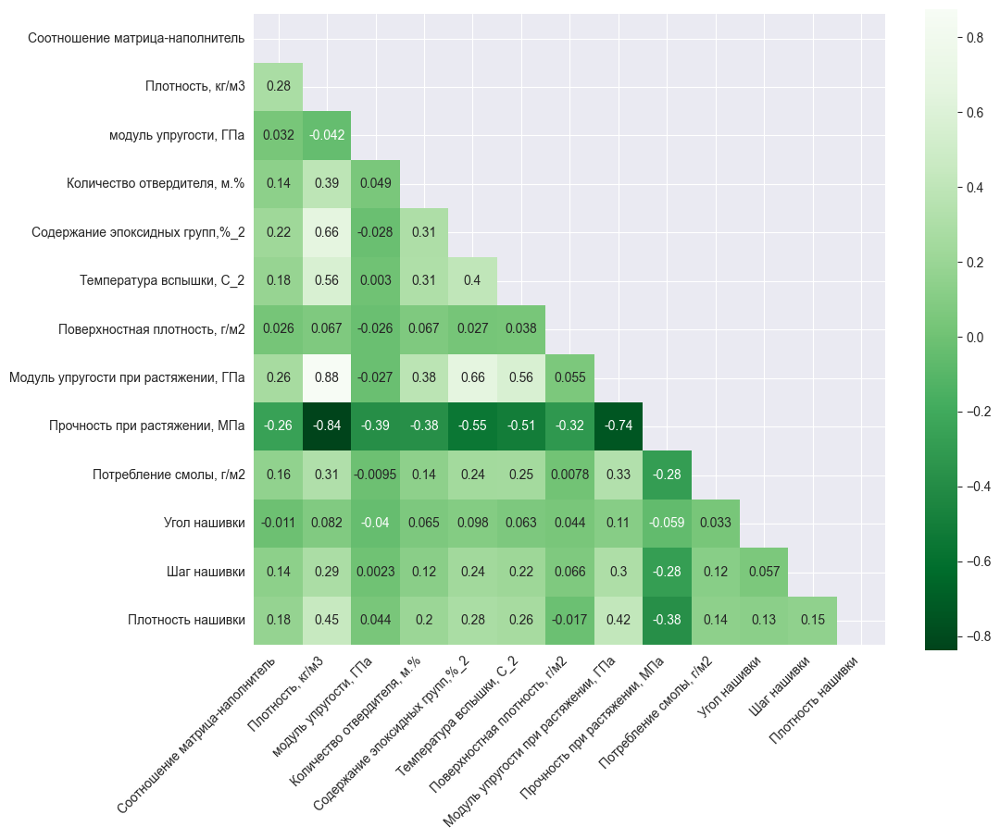

In [81]:
mask = np.triu(X2.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X2.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

In [82]:
df_norm_n.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.000885,0.597049,0.220075,0.033657,0.006717,0.086572,0.144885,0.022174,0.731093,0.065909,0.000155,0.002101,0.017401
std,0.000286,0.064504,0.095713,0.008973,0.001016,0.015045,0.083872,0.002485,0.069235,0.018509,0.000153,0.000808,0.003795
min,0.000163,0.444650,0.000709,0.011339,0.004113,0.049402,0.000230,0.016108,0.463136,0.021630,0.000000,0.000011,0.007195
25%,0.000685,0.552643,0.150901,0.027607,0.005990,0.076193,0.080748,0.020407,0.688177,0.052457,0.000000,0.001543,0.014860
50%,0.000872,0.592130,0.219805,0.033559,0.006654,0.085003,0.140105,0.021973,0.740666,0.065577,0.000244,0.002053,0.017293
75%,0.001068,0.640228,0.289231,0.039565,0.007346,0.096585,0.204309,0.023759,0.780691,0.077899,0.000301,0.002630,0.019756
max,0.001803,0.824241,0.525102,0.062919,0.010887,0.147961,0.414371,0.030620,0.877580,0.122973,0.000419,0.004519,0.030927


In [83]:
df_minmax_n.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### Разработка и обучение нескольких моделей для прогноза прочности при растяжении

In [84]:
'''Данные в нашем итоговом датасете в основном непрерывные и на ум приходит сразу решение данной задачи с использованием регрессионных моделей.
Но попарные графики рассеивания точек и тепловая карта не дают нам реальной взаимосвязи и возможности прямого прогнозирования, 
поэтому будем использовать и категориальные подходы к прогнозированию (например, попробуем метод ближайших соседей) 
или обучение со скрытыми слоями, чтобы выявить дополнительные взаимосвязи.

Задача ВКР на этом этапе звучит так: "При построении моделей провести поиск гиперпараметров модели с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10.'''

'Данные в нашем итоговом датасете в основном непрерывные и на ум приходит сразу решение данной задачи с использованием регрессионных моделей.\nНо попарные графики рассеивания точек и тепловая карта не дают нам реальной взаимосвязи и возможности прямого прогнозирования, \nпоэтому будем использовать и категориальные подходы к прогнозированию (например, попробуем метод ближайших соседей) \nили обучение со скрытыми слоями, чтобы выявить дополнительные взаимосвязи.\n\nЗадача ВКР на этом этапе звучит так: "При построении моделей провести поиск гиперпараметров модели с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10.'

Сформируем выборки и посмотрим, что получилось

In [85]:
# Прогнозируем прочность при растяжении

После всех подготовительных работ переходим к процессу создания, обучения моделей. Мы будем использовать в Python библиотеку Scikit-Learn.
В качестве базового уровня предскажем медианное значение цели на обучающем наборе для всех примеров в тестовом наборе. В качестве метрики возьмём среднюю абсолютную ошибку (mae) в прогнозах. Для обучения используем 70 % данных, а для тестирования — 30 %.